In [204]:
import numpy as np
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt
import os
import folium as fl 
import geopandas as gpd
from sklearn import datasets
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import log_loss
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder
from shapely.geometry import Point
from folium.plugins import HeatMap
from pandas.plotting import scatter_matrix
from scipy import sparse
from scipy import linalg
import scipy 
from datetime import datetime


In [205]:
data = pd.read_excel('Road.xlsx')
data.to_csv('Road.csv', sep=';', index=False)

In [206]:
display(data)

,Accident_Index,Accident Date,Day_of_Week,Junction_Control,Junction_Detail,Accident_Severity,Latitude,Light_Conditions,Local_Authority_(District),Carriageway_Hazards,...,Number_of_Casualties,Number_of_Vehicles,Police_Force,Road_Surface_Conditions,Road_Type,Speed_limit,Time,Urban_or_Rural_Area,Weather_Conditions,Vehicle_Type
0,200901BS70001,2021-01-01,Thursday,Give way or uncontrolled,T or staggered junction,Serious,51.512273,Daylight,Kensington and Chelsea,NaN,...,1,2,Metropolitan Police,Dry,One way street,30,15:11:00,Urban,Fine no high winds,Car
1,200901BS70002,2021-01-05,Monday,Give way or uncontrolled,Crossroads,Serious,51.514399,Daylight,Kensington and Chelsea,NaN,...,11,2,Metropolitan Police,Wet or damp,Single carriageway,30,10:59:00,Urban,Fine no high winds,Taxi/Private hire car
2,200901BS70003,2021-01-04,Sunday,Give way or uncontrolled,T or staggered junction,Slight,51.486668,Daylight,Kensington and Chelsea,NaN,...,1,2,Metropolitan Police,Dry,Single carriageway,30,14:19:00,Urban,Fine no high winds,Taxi/Private hire car
3,200901BS70004,2021-01-05,Monday,Auto traffic signal,T or staggered junction,Serious,51.507804,Daylight,Kensington and Chelsea,NaN,...,1,2,Metropolitan Police,Frost or ice,Single carriageway,30,08:10:00,Urban,Other,Motorcycle over 500cc
4,200901BS70005,2021-01-06,Tuesday,Auto traffic signal,Crossroads,Serious,51.482076,Darkness - lights lit,Kensington and Chelsea,NaN,...,1,2,Metropolitan Police,Dry,Single carriageway,30,17:25:00,Urban,Fine no high winds,Car
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307968,201091NM01760,2022-02-18,Thursday,Data missing or out of range,Not at junction or within 20 metres,Slight,57.374005,Daylight,Highland,NaN,...,2,1,Northern,Dry,Single carriageway,60,07:00:00,Rural,Fine no high winds,Car
307969,201091NM01881,2022-02-21,Sunday,Data missing or out of range,Not at junction or within 20 metres,Slight,57.232273,Darkness - no lighting,Highland,NaN,...,1,1,Northern,Frost or ice,Single carriageway,60,03:00:00,Rural,Fine no high winds,Car
307970,201091NM01935,2022-02-23,Tuesday,Give way or uncontrolled,T or staggered junction,Slight,57.585044,Daylight,Highland,NaN,...,1,3,Northern,Frost or ice,Single carriageway,30,09:38:00,Rural,Fine no high winds,Car
307971,201091NM01964,2022-02-23,Tuesday,Give way or uncontrolled,T or staggered junction,Serious,57.214898,Darkness - no lighting,Highland,NaN,...,1,2,Northern,Wet or damp,Single carriageway,60,18:25:00,Rural,Fine no high winds,Motorcycle over 500cc


In [207]:
print(data.columns)

Index(['Accident_Index', 'Accident Date', 'Day_of_Week', 'Junction_Control',
       'Junction_Detail', 'Accident_Severity', 'Latitude', 'Light_Conditions',
       'Local_Authority_(District)', 'Carriageway_Hazards', 'Longitude',
       'Number_of_Casualties', 'Number_of_Vehicles', 'Police_Force',
       'Road_Surface_Conditions', 'Road_Type', 'Speed_limit', 'Time',
       'Urban_or_Rural_Area', 'Weather_Conditions', 'Vehicle_Type'],
      dtype='object')


In [208]:
print(data.dtypes)

Accident_Index                        object
Accident Date                 datetime64[ns]
Day_of_Week                           object
Junction_Control                      object
Junction_Detail                       object
Accident_Severity                     object
Latitude                             float64
Light_Conditions                      object
Local_Authority_(District)            object
Carriageway_Hazards                   object
Longitude                            float64
Number_of_Casualties                   int64
Number_of_Vehicles                     int64
Police_Force                          object
Road_Surface_Conditions               object
Road_Type                             object
Speed_limit                            int64
Time                                  object
Urban_or_Rural_Area                   object
Weather_Conditions                    object
Vehicle_Type                          object
dtype: object


In [209]:
print(data.isnull().sum())

Accident_Index                     0
Accident Date                      0
Day_of_Week                        0
Junction_Control                   0
Junction_Detail                    0
Accident_Severity                  0
Latitude                           0
Light_Conditions                   0
Local_Authority_(District)         0
Carriageway_Hazards           302549
Longitude                          0
Number_of_Casualties               0
Number_of_Vehicles                 0
Police_Force                       0
Road_Surface_Conditions          317
Road_Type                       1534
Speed_limit                        0
Time                              17
Urban_or_Rural_Area                0
Weather_Conditions              6057
Vehicle_Type                       0
dtype: int64


In [210]:
data['Carriageway_Hazards'] = data['Carriageway_Hazards'].fillna(value="None")


In [211]:
data['Time'] = pd.to_datetime(data['Time'], format='%H:%M:%S')


In [212]:
print(data.isnull().sum())

Accident_Index                   0
Accident Date                    0
Day_of_Week                      0
Junction_Control                 0
Junction_Detail                  0
Accident_Severity                0
Latitude                         0
Light_Conditions                 0
Local_Authority_(District)       0
Carriageway_Hazards              0
Longitude                        0
Number_of_Casualties             0
Number_of_Vehicles               0
Police_Force                     0
Road_Surface_Conditions        317
Road_Type                     1534
Speed_limit                      0
Time                            17
Urban_or_Rural_Area              0
Weather_Conditions            6057
Vehicle_Type                     0
dtype: int64


In [213]:
data = data.dropna()

In [214]:
print(data.isnull().sum())

Accident_Index                0
Accident Date                 0
Day_of_Week                   0
Junction_Control              0
Junction_Detail               0
Accident_Severity             0
Latitude                      0
Light_Conditions              0
Local_Authority_(District)    0
Carriageway_Hazards           0
Longitude                     0
Number_of_Casualties          0
Number_of_Vehicles            0
Police_Force                  0
Road_Surface_Conditions       0
Road_Type                     0
Speed_limit                   0
Time                          0
Urban_or_Rural_Area           0
Weather_Conditions            0
Vehicle_Type                  0
dtype: int64


In [215]:
data.shape

(300495, 21)

In [216]:
data['Junction_Control'] = data['Junction_Control'].replace('Auto traffic sigl', 'Auto traffic signal')

In [217]:
data['Accident_Severity']= data['Accident_Severity'].replace('Fetal', 'Fatal')

In [218]:
label_encoder = LabelEncoder()
encoded_data = pd.DataFrame()
help = data 
help = help.drop(['Latitude', 'Longitude', 'Accident_Index'], axis=1)

for column in help.columns:
    if help[column].dtype == "object":
        encoded_data[column + "_Encoded"] = label_encoder.fit_transform(help[column])
    else:
        encoded_data[column] = help[column]
display(encoded_data)

,Accident Date,Day_of_Week_Encoded,Junction_Control_Encoded,Junction_Detail_Encoded,Accident_Severity_Encoded,Light_Conditions_Encoded,Local_Authority_(District)_Encoded,Carriageway_Hazards_Encoded,Number_of_Casualties,Number_of_Vehicles,Police_Force_Encoded,Road_Surface_Conditions_Encoded,Road_Type_Encoded,Speed_limit,Time,Urban_or_Rural_Area_Encoded,Weather_Conditions_Encoded,Vehicle_Type_Encoded
0,2021-01-01,4,3,8,1,4,185,1,1,2,29,0,1,30,1900-01-01 15:11:00,1,1,2
1,2021-01-05,1,3,0,1,4,185,1,11,2,29,4,3,30,1900-01-01 10:59:00,1,1,13
2,2021-01-04,3,3,8,2,4,185,1,1,2,29,0,3,30,1900-01-01 14:19:00,1,1,13
3,2021-01-05,1,1,8,1,4,185,1,1,2,29,2,3,30,1900-01-01 08:10:00,1,3,9
4,2021-01-06,5,1,0,1,1,185,1,1,2,29,0,3,30,1900-01-01 17:25:00,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307968,2022-02-18,4,2,3,2,4,172,1,2,1,34,0,3,60,1900-01-01 07:00:00,0,1,2
307969,2022-02-21,3,2,3,2,3,172,1,1,1,34,2,3,60,1900-01-01 03:00:00,0,1,2
307970,2022-02-23,5,3,8,2,4,172,1,1,3,34,2,3,30,1900-01-01 09:38:00,0,1,2
307971,2022-02-23,5,3,8,1,3,172,1,1,2,34,4,3,60,1900-01-01 18:25:00,0,1,9


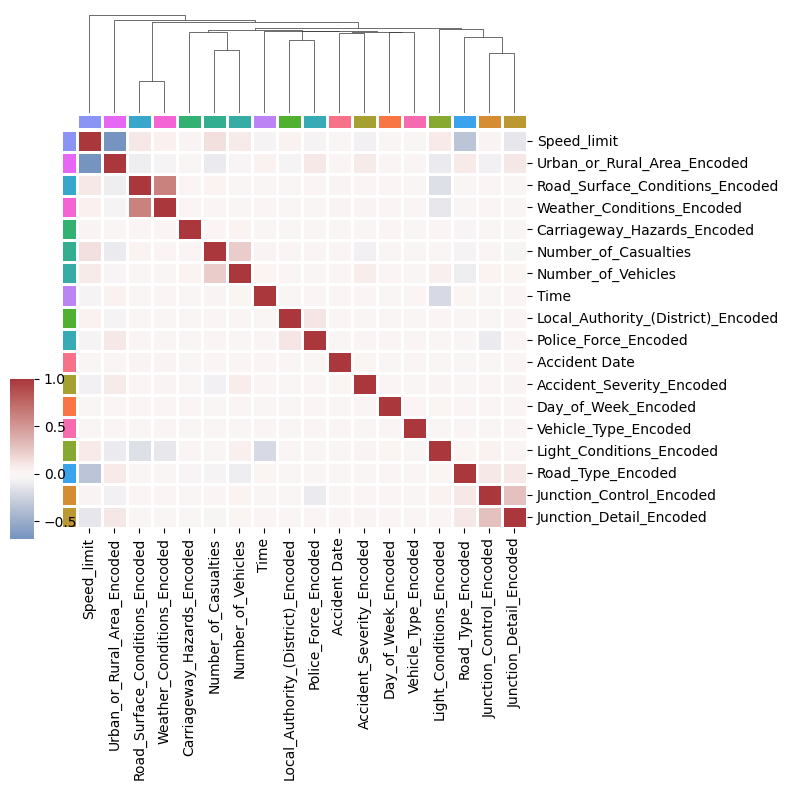

In [219]:
palette = sns.color_palette("husl", n_colors=len(encoded_data.columns))

# Zeichnen Sie das Cluster-Heatmap-Diagramm
g = sns.clustermap(encoded_data.corr(), center=0, cmap="vlag",
                   row_colors=palette, col_colors=palette,
                   dendrogram_ratio=(.1, .2),
                   cbar_pos=(.02, .32, .03, .2),
                   linewidths=.75, figsize=(8, 8))

# Entfernen Sie das Zeilendendrogramm
g.ax_row_dendrogram.remove()

plt.show()

Unfälle Insgesamt

Time
1900-01-01 08:00:00    5
Name: count, dtype: int64


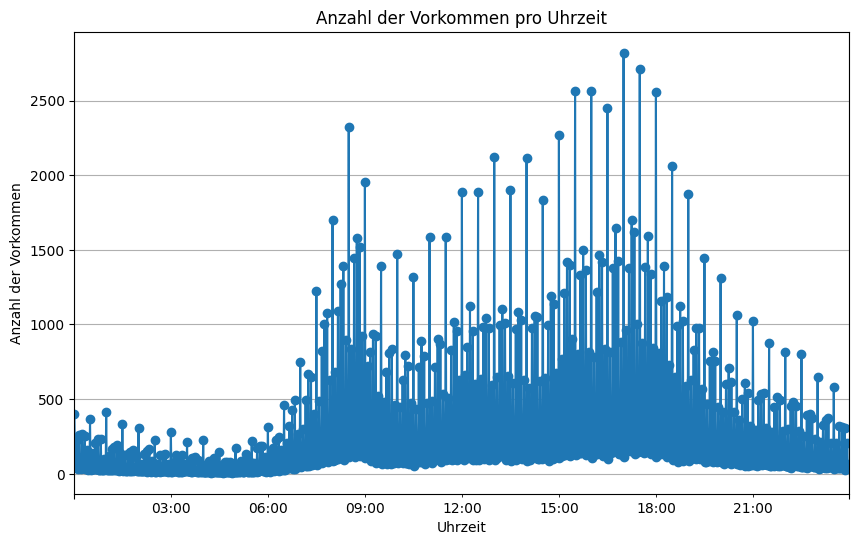

In [220]:
count_per_time= data['Time'].value_counts()
print(x)
count_per_time = count_per_time.sort_index()

# Plot des Liniendiagramms
count_per_time.plot(kind='line', marker='o', figsize=(10, 6))
plt.title('Anzahl der Vorkommen pro Uhrzeit')
plt.xlabel('Uhrzeit')
plt.ylabel('Anzahl der Vorkommen')
plt.grid(True)
plt.show()

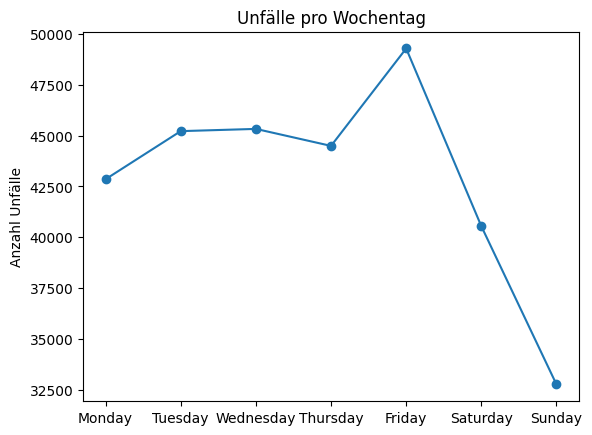

In [221]:
atab = {
    'Day_of_Week': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
    'count': [42855, 45221, 45331, 44495,  49287, 40546, 32760]
}
plt.plot(atab['Day_of_Week'], atab['count'], marker='o')
plt.ylabel('Anzahl Unfälle')
plt.title('Unfälle pro Wochentag')  
plt.show()

In [222]:
b = data['Junction_Control'].value_counts()
#print(b)

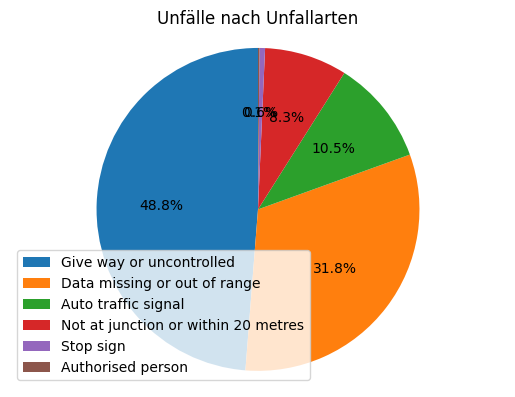

In [223]:
btab = {
    'Junction_Control': ['Give way or uncontrolled', 'Data missing or out of range', 'Auto traffic signal', 'Not at junction or within 20 metres', 'Stop sign', 'Authorised person', ],
    'count': [146515, 95427, 31560, 24889, 1655, 449]
}
plt.pie(btab['count'], autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.subplots_adjust(top=0.85)
plt.title('Unfälle nach Unfallarten')
plt.legend(btab['Junction_Control'])
plt.show()

In [224]:
c = data['Junction_Detail'].value_counts()
#print(c)

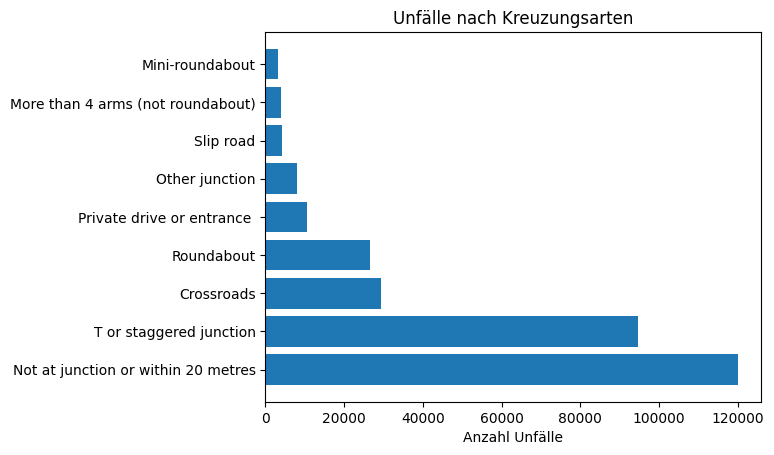

In [225]:
ctab = {
    'Junction_Detail': ['Not at junction or within 20 metres', 'T or staggered junction', 'Crossroads', 'Roundabout', 'Private drive or entrance ', 'Other junction', 'Slip road', 'More than 4 arms (not roundabout)', 'Mini-roundabout'],
    'count': [ 119987, 94696, 29354, 26524, 10518, 7923, 4192, 4029, 3272]
}
plt.barh(ctab['Junction_Detail'], ctab['count'])
plt.xlabel('Anzahl Unfälle')
plt.title('Unfälle nach Kreuzungsarten')  
plt.show()

In [226]:
d = data['Accident_Severity'].value_counts()
#print(d)

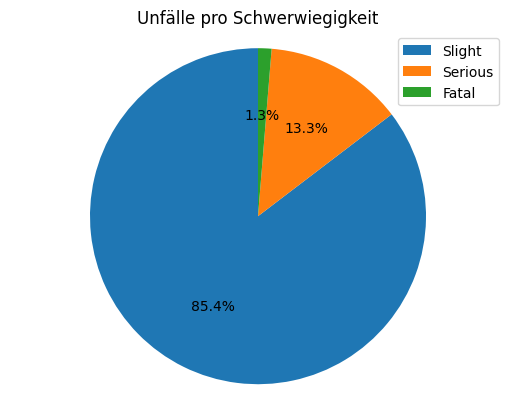

In [227]:
dtab = {
    'Accident_Serverity': ['Slight', 'Serious', 'Fatal'],
    'count': [256519, 40084, 3892]
}
plt.pie(dtab['count'], autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Unfälle pro Schwerwiegigkeit')
plt.legend(dtab['Accident_Serverity'])
plt.show()

In [228]:
e = data['Light_Conditions'].value_counts()
#print(e)

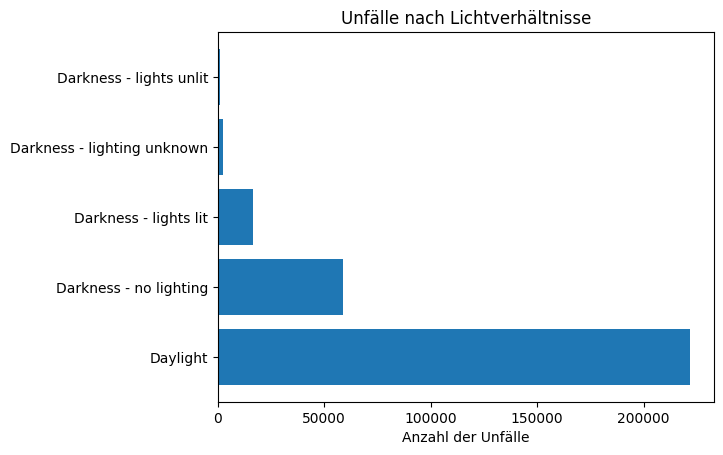

In [229]:
etab = {
    'Light_Conditions': ['Daylight', 'Darkness - no lighting', 'Darkness - lights lit', 'Darkness - lighting unknown' , 'Darkness - lights unlit'],
    'count': [221884, 59009, 16277, 2216, 1109]
}
plt.barh(etab['Light_Conditions'], etab['count'])
plt.xlabel('Anzahl der Unfälle')
plt.title('Unfälle nach Lichtverhältnisse')  
plt.show()

In [230]:
f = data['Number_of_Casualties'].value_counts()
#print(f)

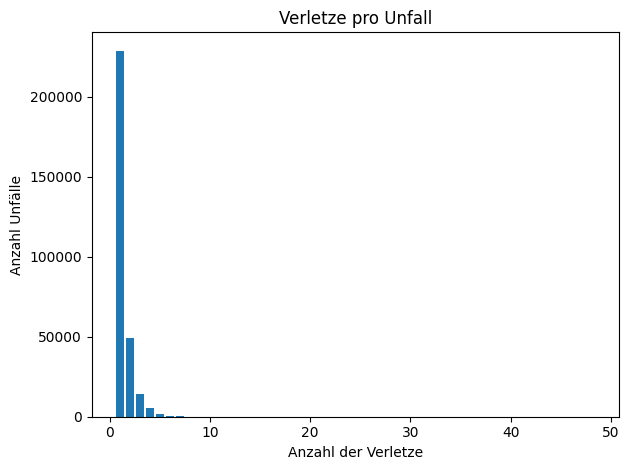

In [231]:
ftab = {'Number_of_Casualties': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 11, 13, 14, 17, 18, 16, 15, 21, 24, 19, 27, 48, 40, 22, 42, 43],
        'count': [228953, 49096, 14111, 5261, 1880, 709, 236, 100, 44, 34, 14, 14, 9, 7, 5, 4, 3, 3, 2, 2, 1, 1, 1, 1, 1, 1, 1]}

# DataFrame erstellen
plt.bar(ftab['Number_of_Casualties'], ftab['count'])
plt.xlabel('Anzahl der Verletze')
plt.ylabel('Anzahl Unfälle')
plt.title('Verletze pro Unfall')  
plt.tight_layout()  
plt.show()

In [232]:
g = data['Number_of_Vehicles'].value_counts()
#print(g)

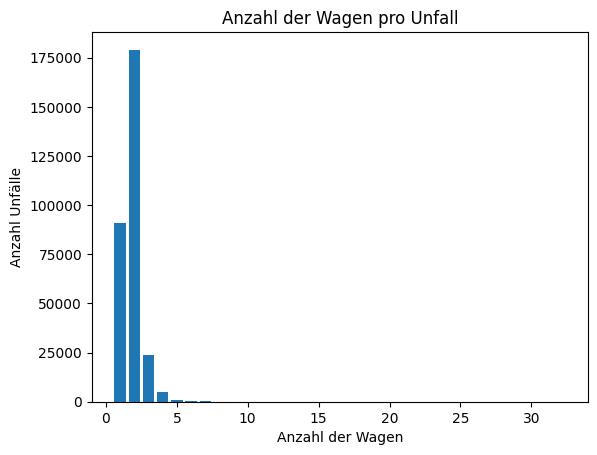

In [233]:
gtab = {
    'Number_of_Vehicles': [2, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 12, 14, 16, 32],
    'count': [179064, 90936, 23810, 4988, 1107, 340, 126, 63, 30, 11, 6, 5, 4, 2, 1, 1]
    }

plt.bar(gtab['Number_of_Vehicles'], gtab['count'])
plt.xlabel('Anzahl der Wagen')
plt.ylabel('Anzahl Unfälle')
plt.title('Anzahl der Wagen pro Unfall') 
plt.show()

In [234]:
h = data['Road_Surface_Conditions'].value_counts()
#print(h)

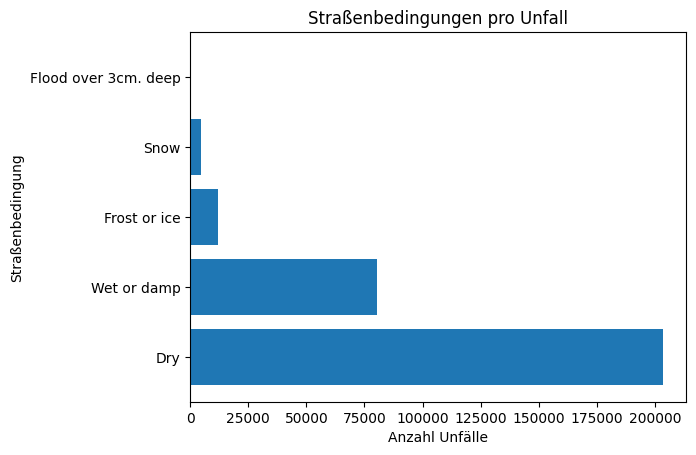

In [235]:
htab = {'Road_Surface_Conditions': ['Dry', 'Wet or damp', 'Frost or ice', 'Snow', 'Flood over 3cm. deep'],
        'count': [203269, 80299, 11874, 4691, 362]}
plt.barh(htab['Road_Surface_Conditions'], htab['count'])
plt.xlabel('Anzahl Unfälle')
plt.ylabel('Straßenbedingung')
plt.title('Straßenbedingungen pro Unfall') 
plt.show()

In [236]:
i = data['Road_Type'].value_counts()
#print(i)

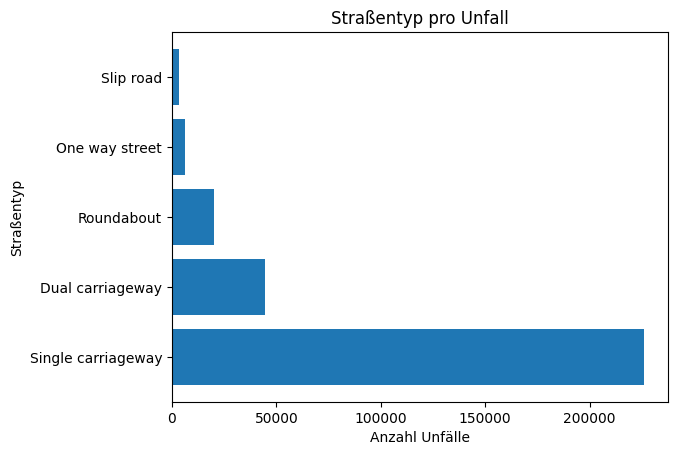

In [237]:
itab = {'Road_Type': ['Single carriageway', 'Dual carriageway', 'Roundabout', 'One way street', 'Slip road'],
        'count': [226167, 44737, 20360, 6051, 3180]}
plt.barh(itab['Road_Type'], itab['count'])
plt.xlabel('Anzahl Unfälle')
plt.ylabel('Straßentyp')
plt.title('Straßentyp pro Unfall')
plt.show()

In [238]:
j = data['Speed_limit'].value_counts()
#print(j)

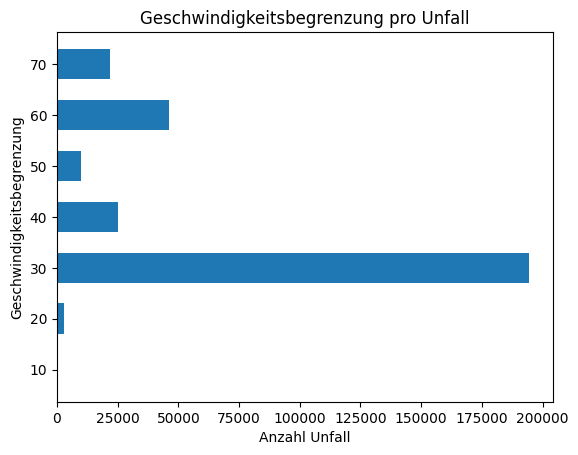

In [239]:
jtab = {'Speed_limit': [30, 60, 40, 70, 50, 20, 10, 15],
        'count': [194513, 46056, 25163, 21971, 10000, 2788, 2, 2]}
plt.barh(jtab['Speed_limit'], jtab['count'], height=6)
plt.xlabel('Anzahl Unfall')
plt.ylabel('Geschwindigkeitsbegrenzung')
plt.title('Geschwindigkeitsbegrenzung pro Unfall') 
plt.show()

In [242]:
l = data['Urban_or_Rural_Area'].value_counts()
#print(l)

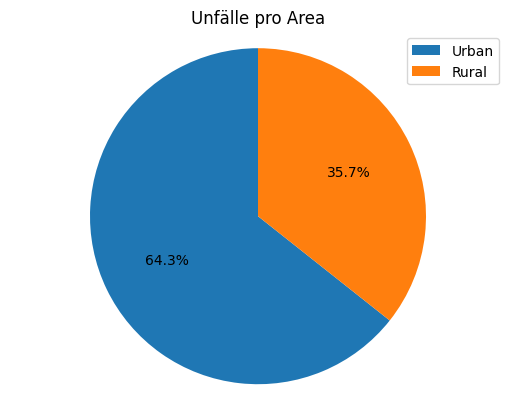

In [243]:
ltab = {'Urban_or_Rural_Area': ['Urban', 'Rural'], 'count': [193341, 107154]}
plt.pie(ltab['count'], autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Unfälle pro Area')
plt.legend(ltab['Urban_or_Rural_Area'])
plt.show()

In [244]:
m = data['Weather_Conditions'].value_counts()
#print(m)

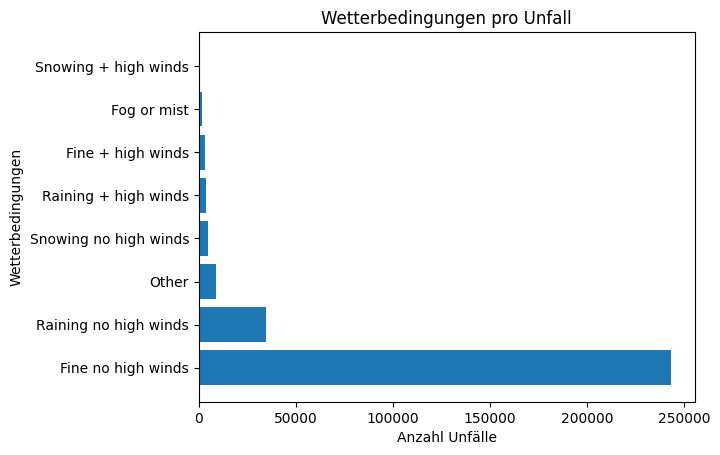

In [245]:
mtab = {
    'Weather_Conditions': ['Fine no high winds', 'Raining no high winds', 'Other', 
                            'Snowing no high winds', 'Raining + high winds', 
                            'Fine + high winds', 'Fog or mist', 'Snowing + high winds'],
    'count': [243333, 34733, 8752, 4815, 3508, 3136, 1681, 537]
}
plt.barh(mtab['Weather_Conditions'], mtab['count'])
plt.xlabel('Anzahl Unfälle')
plt.ylabel('Wetterbedingungen')
plt.title('Wetterbedingungen pro Unfall')  
plt.show()

In [246]:
n = data['Vehicle_Type'].value_counts()
#print(n)

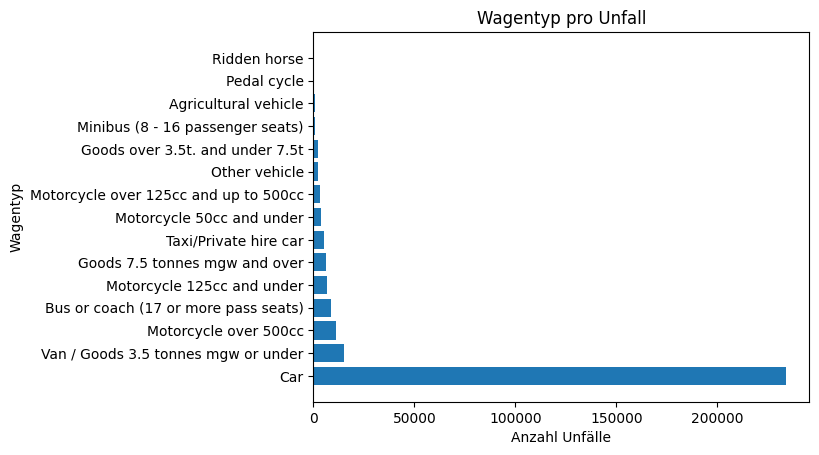

In [247]:
ntab = {
    'Vehicle_Type': ['Car', 'Van / Goods 3.5 tonnes mgw or under', 'Motorcycle over 500cc', 
                     'Bus or coach (17 or more pass seats)', 'Motorcycle 125cc and under', 
                     'Goods 7.5 tonnes mgw and over', 'Taxi/Private hire car', 
                     'Motorcycle 50cc and under', 'Motorcycle over 125cc and up to 500cc', 
                     'Other vehicle', 'Goods over 3.5t. and under 7.5t', 
                     'Minibus (8 - 16 passenger seats)', 'Agricultural vehicle', 
                     'Pedal cycle', 'Ridden horse'],
    'count': [233965, 15312, 10959, 8497, 6687, 6354, 5403, 3618, 3217, 2448, 2447, 804, 716, 65, 3]
}
plt.barh(ntab['Vehicle_Type'], ntab['count'])
plt.xlabel('Anzahl Unfälle')
plt.ylabel('Wagentyp')
plt.title('Wagentyp pro Unfall')
plt.show()

In [248]:
o = data['Carriageway_Hazards'].value_counts()
#print(o)

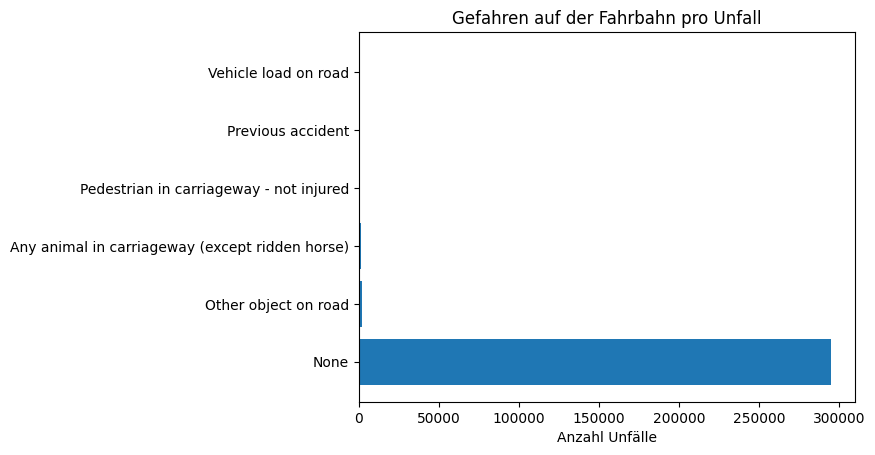

In [249]:
otab = {
    'Carriageway_Hazards': ['None', 'Other object on road', 'Any animal in carriageway (except ridden horse)', 'Pedestrian in carriageway - not injured', 'Previous accident', 'Vehicle load on road'],
    'count': [295190, 2194, 1597, 679, 508, 327]
}
plt.barh(otab['Carriageway_Hazards'], otab['count'])
plt.xlabel('Anzahl Unfälle')
plt.title('Gefahren auf der Fahrbahn pro Unfall')
plt.show()

Zahl der Verletzten

In [250]:
licht_sum = data.groupby('Light_Conditions')['Number_of_Casualties'].sum().reset_index()
licht_zeile = data['Light_Conditions'].value_counts().reset_index()
licht_zeile.columns = ['Light_Conditions', 'row_count']
licht = pd.merge(licht_sum, licht_zeile, on='Light_Conditions')
licht['avg_casualties'] = licht['Number_of_Casualties'] / licht['row_count']
#print(licht)

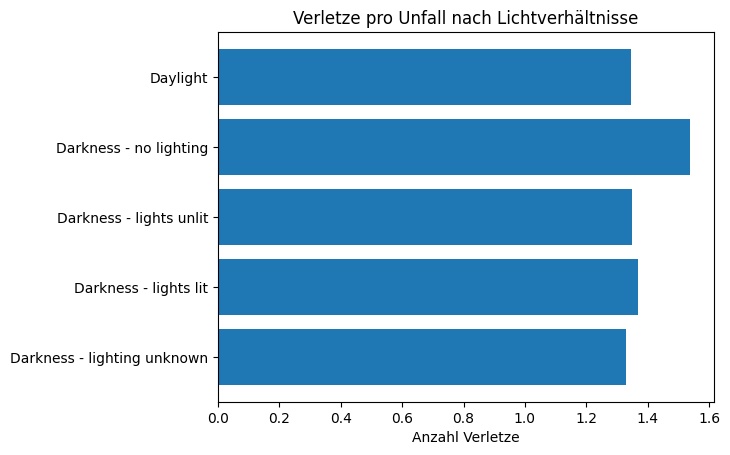

In [251]:
plt.barh(licht['Light_Conditions'], licht['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Lichtverhältnisse')  
plt.show()

In [252]:
datum_sum = data.groupby('Accident Date')['Number_of_Casualties'].sum().reset_index()
datum_zeile = data['Accident Date'].value_counts().reset_index()
datum_zeile.columns = ['Accident Date', 'row_count']
datum = pd.merge(datum_sum, datum_zeile, on='Accident Date')
datum['avg_casualties'] = datum['Number_of_Casualties'] / datum['row_count']
#print(licht)

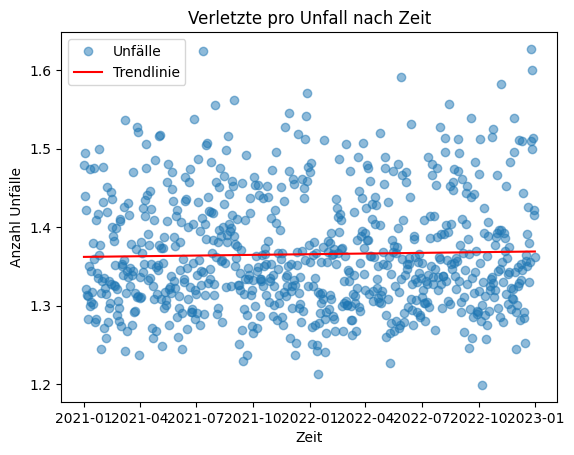

In [283]:
plt.plot(datum['Accident Date'], datum['avg_casualties'], marker='o', linestyle='', label='Unfälle', alpha = 0.5)  
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
plt.title('Verletzte pro Unfall nach Zeit')
x = np.arange(len(datum['Accident Date']))
y = datum['avg_casualties']
coefficients = np.polyfit(x, y, 1) 
trendline = np.poly1d(coefficients)(x)
plt.plot(datum['Accident Date'], trendline, color='red', label='Trendlinie')
plt.legend()
plt.show()

In [254]:
tag_sum = data.groupby('Day_of_Week')['Number_of_Casualties'].sum().reset_index()
tag_zeile = data['Day_of_Week'].value_counts().reset_index()
tag_zeile.columns = ['Day_of_Week', 'row_count']
tag = pd.merge(tag_sum, tag_zeile, on='Day_of_Week')
tag['avg_casualties'] = tag['Number_of_Casualties'] / tag['row_count']
#print(control)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


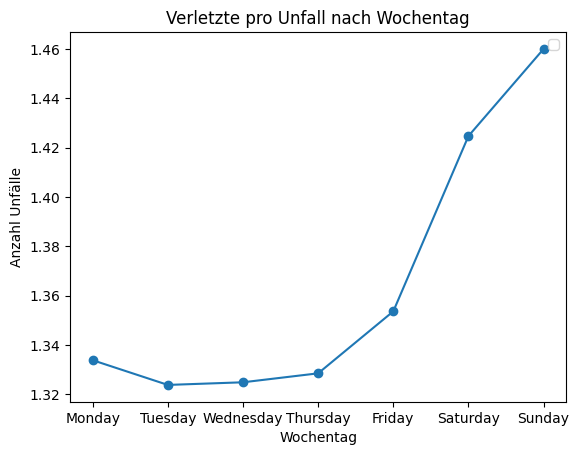

In [255]:
weekday_mapping = {'Monday': 1, 'Tuesday': 2, 'Wednesday': 3, 'Thursday': 4, 'Friday': 5, 'Saturday': 6, 'Sunday': 7}

sorted_weekdays = sorted(weekday_mapping, key=weekday_mapping.get)

filtered_data = {day: tag['avg_casualties'][tag['Day_of_Week'] == day] for day in sorted_weekdays}
x_values = [weekday_mapping[day] for day in sorted_weekdays]

y_values = [filtered_data[day].mean() for day in sorted_weekdays]

plt.plot(x_values, y_values, marker='o', linestyle='-')
plt.xticks(x_values, sorted_weekdays) 
plt.xlabel('Wochentag')
plt.ylabel('Anzahl Unfälle')
plt.title('Verletzte pro Unfall nach Wochentag')
plt.legend()
plt.show()

In [256]:
control_sum = data.groupby('Junction_Control')['Number_of_Casualties'].sum().reset_index()
control_zeile = data['Junction_Control'].value_counts().reset_index()
control_zeile.columns = ['Junction_Control', 'row_count']
control = pd.merge(control_sum, control_zeile, on='Junction_Control')
control['avg_casualties'] = control['Number_of_Casualties'] / control['row_count']
#print(control)

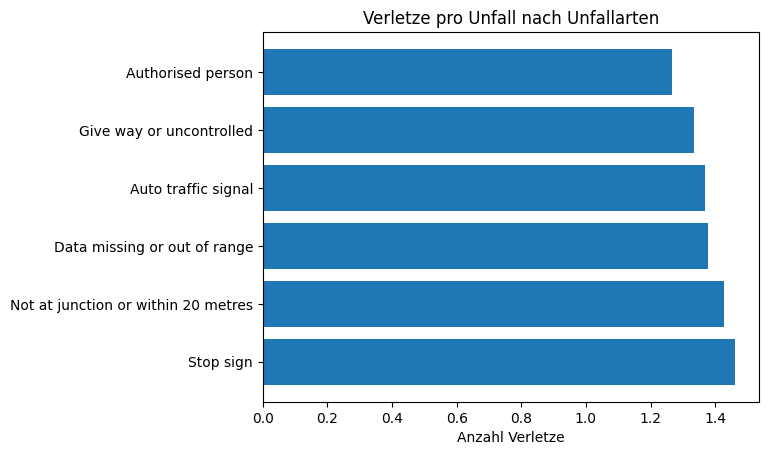

In [257]:
sorted_control = control.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_control['Junction_Control'], sorted_control['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Unfallarten')  
plt.show()

In [258]:
detail_sum = data.groupby('Junction_Detail')['Number_of_Casualties'].sum().reset_index()
detail_zeile = data['Junction_Detail'].value_counts().reset_index()
detail_zeile.columns = ['Junction_Detail', 'row_count']
detail = pd.merge(detail_sum, detail_zeile, on='Junction_Detail')
detail['avg_casualties'] = detail['Number_of_Casualties'] / detail['row_count']
#print(detail)

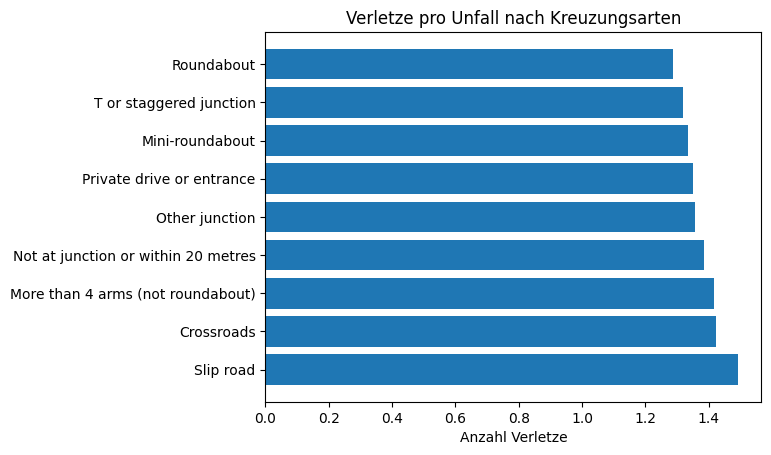

In [259]:
sorted_detail = detail.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_detail['Junction_Detail'], sorted_detail['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Kreuzungsarten')  
plt.show()

In [260]:
schwer_sum = data.groupby('Accident_Severity')['Number_of_Casualties'].sum().reset_index()
schwer_zeile = data['Accident_Severity'].value_counts().reset_index()
schwer_zeile.columns = ['Accident_Severity', 'row_count']
schwer = pd.merge(schwer_sum, schwer_zeile, on='Accident_Severity')
schwer['avg_casualties'] = schwer['Number_of_Casualties'] / schwer['row_count']
#print(schwer)

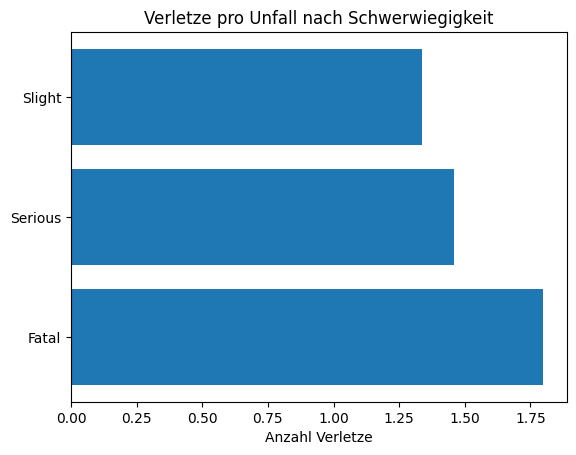

In [261]:
plt.barh(schwer['Accident_Severity'], schwer['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Schwerwiegigkeit')  
plt.show()

In [262]:
anzahl_sum = data.groupby('Number_of_Vehicles')['Number_of_Casualties'].sum().reset_index()
anzahl_zeile = data['Number_of_Vehicles'].value_counts().reset_index()
anzahl_zeile.columns = ['Number_of_Vehicles', 'row_count']
anzahl = pd.merge(anzahl_sum, anzahl_zeile, on='Number_of_Vehicles')
anzahl['avg_casualties'] = anzahl['Number_of_Casualties'] / anzahl['row_count']
#print(anzahl)

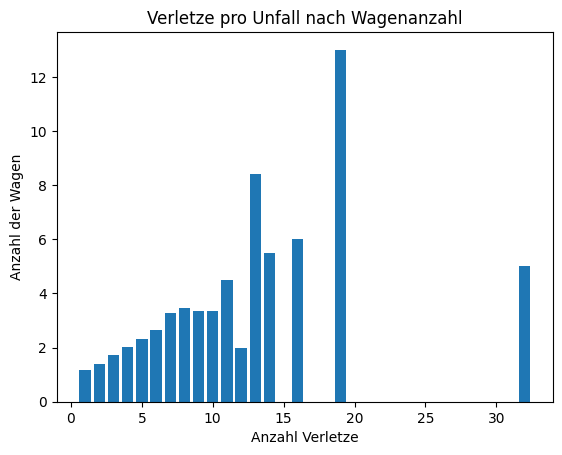

In [263]:
plt.bar(anzahl['Number_of_Vehicles'], anzahl['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.ylabel('Anzahl der Wagen')
plt.title('Verletze pro Unfall nach Wagenanzahl')  
plt.show()

In [264]:
polizei_sum = data.groupby('Police_Force')['Number_of_Casualties'].sum().reset_index()
polizei_zeile = data['Police_Force'].value_counts().reset_index()
polizei_zeile.columns = ['Police_Force', 'row_count']
polizei = pd.merge(polizei_sum, polizei_zeile, on='Police_Force')
polizei['avg_casualties'] = polizei['Number_of_Casualties'] / polizei['row_count']
#print(polizei)

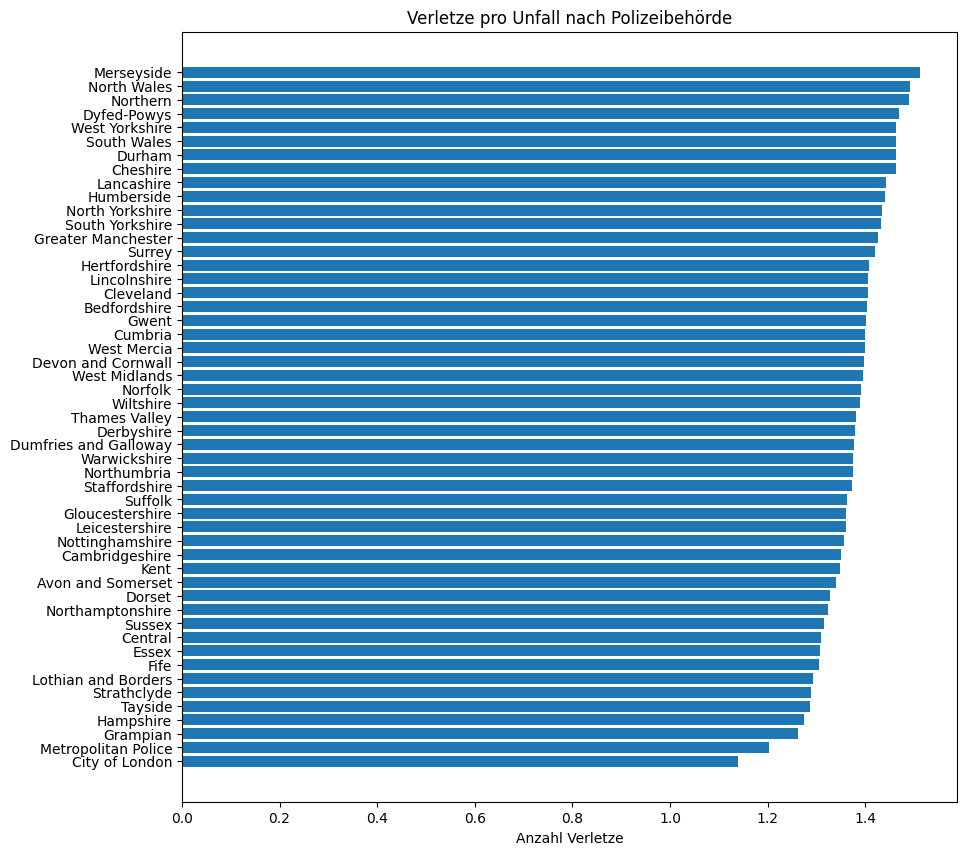

In [265]:
plt.figure(figsize=(10, 10))
sorted_polizei = sorted(zip(polizei['Police_Force'], polizei['avg_casualties']), key=lambda x: x[1])
sorted_polizei_names = [entry[0] for entry in sorted_polizei]
sorted_polizei_values = [entry[1] for entry in sorted_polizei]
plt.barh(sorted_polizei_names, sorted_polizei_values)  
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Polizeibehörde') 
plt.show()

In [266]:
naesse_sum = data.groupby('Road_Surface_Conditions')['Number_of_Casualties'].sum().reset_index()
naesse_zeile = data['Road_Surface_Conditions'].value_counts().reset_index()
naesse_zeile.columns = ['Road_Surface_Conditions', 'row_count']
naesse = pd.merge(naesse_sum, naesse_zeile, on='Road_Surface_Conditions')
naesse['avg_casualties'] = naesse['Number_of_Casualties'] / naesse['row_count']
#print(naesse)

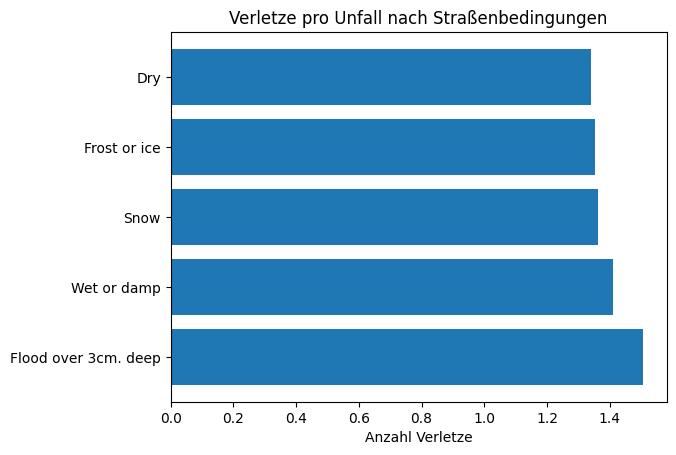

In [267]:
sorted_naesse = naesse.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_naesse['Road_Surface_Conditions'], sorted_naesse['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Straßenbedingungen') 
plt.show()

In [268]:
strasse_sum = data.groupby('Road_Type')['Number_of_Casualties'].sum().reset_index()
strasse_zeile = data['Road_Type'].value_counts().reset_index()
strasse_zeile.columns = ['Road_Type', 'row_count']
strasse = pd.merge(strasse_sum, strasse_zeile, on='Road_Type')
strasse['avg_casualties'] = strasse['Number_of_Casualties'] / strasse['row_count']
#print(strasse)

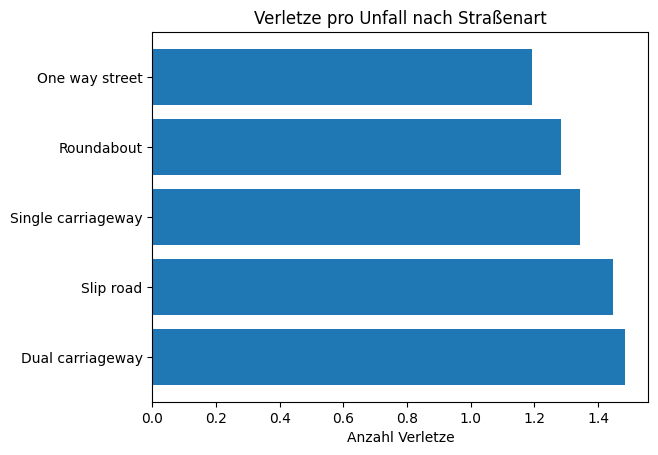

In [269]:
sorted_strasse = strasse.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_strasse['Road_Type'], sorted_strasse['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Straßenart') 
plt.show()

In [270]:
speed_sum = data.groupby('Speed_limit')['Number_of_Casualties'].sum().reset_index()
speed_zeile = data['Speed_limit'].value_counts().reset_index()
speed_zeile.columns = ['Speed_limit', 'row_count']
speed = pd.merge(speed_sum, speed_zeile, on='Speed_limit')
speed['avg_casualties'] = speed['Number_of_Casualties'] / speed['row_count']
#print(speed)

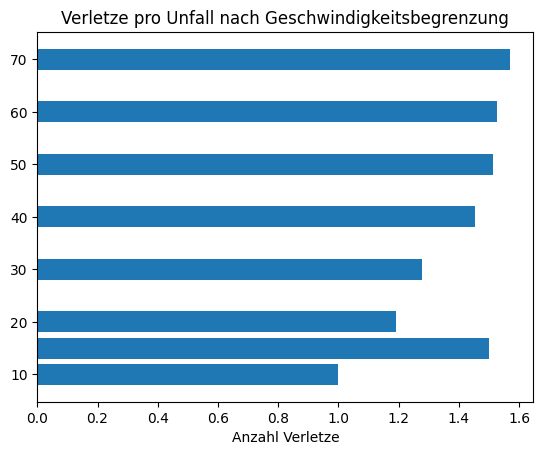

In [271]:
plt.barh(speed['Speed_limit'], speed['avg_casualties'], height=4)
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Geschwindigkeitsbegrenzung') 
plt.show()

In [272]:
ur_sum = data.groupby('Urban_or_Rural_Area')['Number_of_Casualties'].sum().reset_index()
ur_zeile = data['Urban_or_Rural_Area'].value_counts().reset_index()
ur_zeile.columns = ['Urban_or_Rural_Area', 'row_count']
ur = pd.merge(ur_sum, ur_zeile, on='Urban_or_Rural_Area')
ur['avg_casualties'] = ur['Number_of_Casualties'] / ur['row_count']
#print(ur)

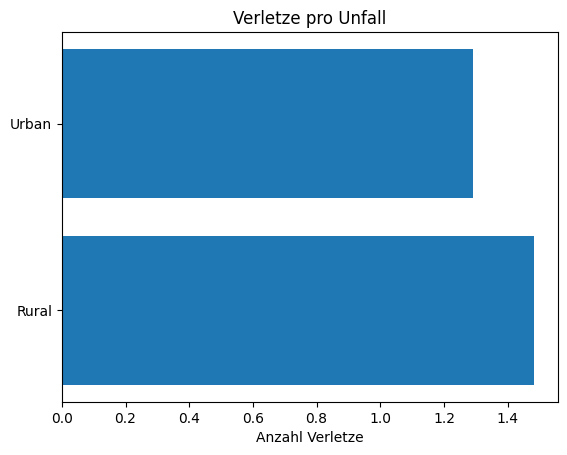

In [273]:
plt.barh(ur['Urban_or_Rural_Area'], ur['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall') 
plt.show()

In [274]:
wetter_sum = data.groupby('Weather_Conditions')['Number_of_Casualties'].sum().reset_index()
wetter_zeile = data['Weather_Conditions'].value_counts().reset_index()
wetter_zeile.columns = ['Weather_Conditions', 'row_count']
wetter = pd.merge(wetter_sum, wetter_zeile, on='Weather_Conditions')
wetter['avg_casualties'] = wetter['Number_of_Casualties'] / wetter['row_count']
#print(wetter)

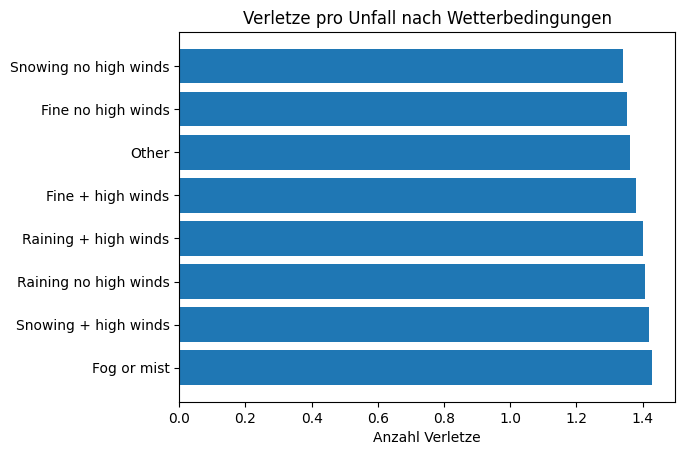

In [275]:
sorted_wetter = wetter.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_wetter['Weather_Conditions'], sorted_wetter['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Wetterbedingungen') 
plt.show()

In [276]:
auto_sum = data.groupby('Vehicle_Type')['Number_of_Casualties'].sum().reset_index()
auto_zeile = data['Vehicle_Type'].value_counts().reset_index()
auto_zeile.columns = ['Vehicle_Type', 'row_count']
auto = pd.merge(auto_sum, auto_zeile, on='Vehicle_Type')
auto['avg_casualties'] = auto['Number_of_Casualties'] / auto['row_count']
#print(auto)

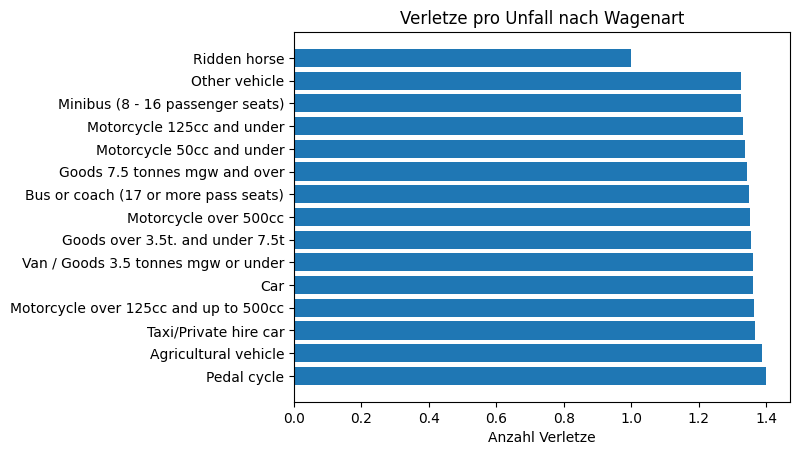

In [277]:
sorted_auto = auto.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_auto['Vehicle_Type'], sorted_auto['avg_casualties'])
plt.xlabel('Anzahl Verletze')
plt.title('Verletze pro Unfall nach Wagenart') 
plt.show()

Wagenanzahl pro Unfall

In [278]:
licht2_sum = data.groupby('Light_Conditions')['Number_of_Vehicles'].sum().reset_index()
licht2_zeile = data['Light_Conditions'].value_counts().reset_index()
licht2_zeile.columns = ['Light_Conditions', 'row_count']
licht2 = pd.merge(licht2_sum, licht2_zeile, on='Light_Conditions')
licht2['avg_casualties'] = licht2['Number_of_Vehicles'] / licht2['row_count']
#print(licht2)

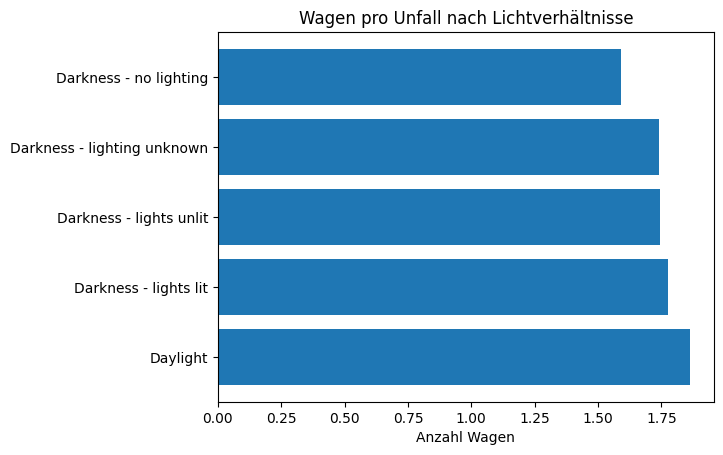

In [279]:
sorted_licht2 = licht2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_licht2['Light_Conditions'], sorted_licht2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Lichtverhältnisse')  
plt.show()

In [281]:
datum2_sum = data.groupby('Accident Date')['Number_of_Vehicles'].sum().reset_index()
datum2_zeile = data['Accident Date'].value_counts().reset_index()
datum2_zeile.columns = ['Accident Date', 'row_count']
datum2 = pd.merge(datum2_sum, datum2_zeile, on='Accident Date')
datum2['avg_casualties'] = datum2['Number_of_Vehicles'] / datum2['row_count']

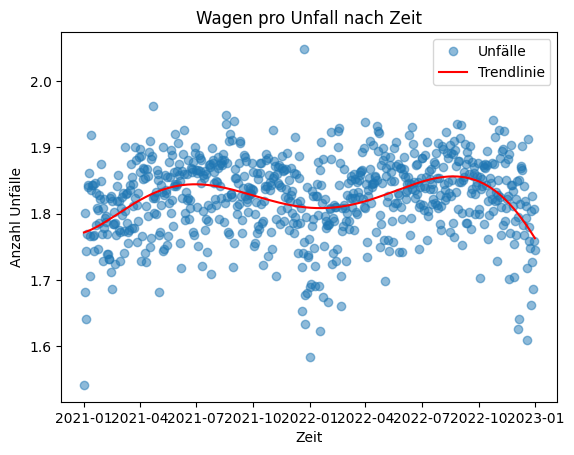

In [284]:
plt.plot(datum2['Accident Date'], datum2['avg_casualties'], marker='o', linestyle='', label='Unfälle', alpha = 0.5)  
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
plt.title('Wagen pro Unfall nach Zeit')
x = np.arange(len(datum2['Accident Date']))
y = datum2['avg_casualties']
coefficients = np.polyfit(x, y, 6) 
trendline = np.poly1d(coefficients)(x)
plt.plot(datum['Accident Date'], trendline, color='red', label='Trendlinie')
plt.legend()
plt.show()

In [306]:
zeit_sum = data.groupby('Time')['Number_of_Vehicles'].sum().reset_index()
zeit_zeile = data['Time'].value_counts().reset_index()
zeit_zeile.columns = ['Time', 'row_count']
zeit = pd.merge(zeit_sum, zeit_zeile, on='Time')
zeit['avg_casualties'] = zeit['Number_of_Vehicles'] / zeit['row_count']
print(zeit)

                    Time  Number_of_Vehicles  row_count  avg_casualties
0    1900-01-01 00:01:00                 626        401        1.561097
1    1900-01-01 00:02:00                 111         67        1.656716
2    1900-01-01 00:03:00                  68         48        1.416667
3    1900-01-01 00:04:00                  86         54        1.592593
4    1900-01-01 00:05:00                 355        226        1.570796
...                  ...                 ...        ...             ...
1434 1900-01-01 23:55:00                 336        207        1.623188
1435 1900-01-01 23:56:00                  58         38        1.526316
1436 1900-01-01 23:57:00                  66         42        1.571429
1437 1900-01-01 23:58:00                  83         53        1.566038
1438 1900-01-01 23:59:00                  92         64        1.437500

[1439 rows x 4 columns]


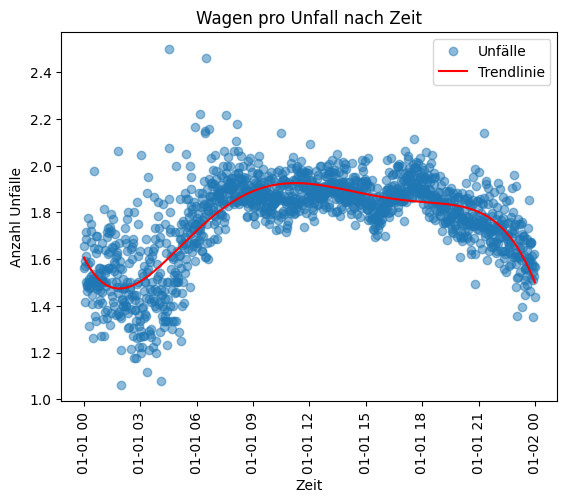

In [307]:
plt.plot(zeit['Time'], zeit['avg_casualties'], marker='o', linestyle='', label='Unfälle', alpha = 0.5)  
plt.xlabel('Zeit')
plt.xticks(rotation = 90)
plt.ylabel('Anzahl Unfälle')
plt.title('Wagen pro Unfall nach Zeit')
x = np.arange(len(zeit['Time']))
y = zeit['avg_casualties']
coefficients = np.polyfit(x, y, 5) 
trendline = np.poly1d(coefficients)(x)
plt.plot(zeit['Time'], trendline, color='red', label='Trendlinie')
plt.legend()
plt.show()

In [ ]:
tag2_sum = data.groupby('Day_of_Week')['Number_of_Vehicles'].sum().reset_index()
tag2_zeile = data['Day_of_Week'].value_counts().reset_index()
tag2_zeile.columns = ['Day_of_Week', 'row_count']
tag2 = pd.merge(tag2_sum, tag2_zeile, on='Day_of_Week')
tag2['avg_casualties'] = tag2['Number_of_Vehicles'] / tag2['row_count']
#print(tag2)


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


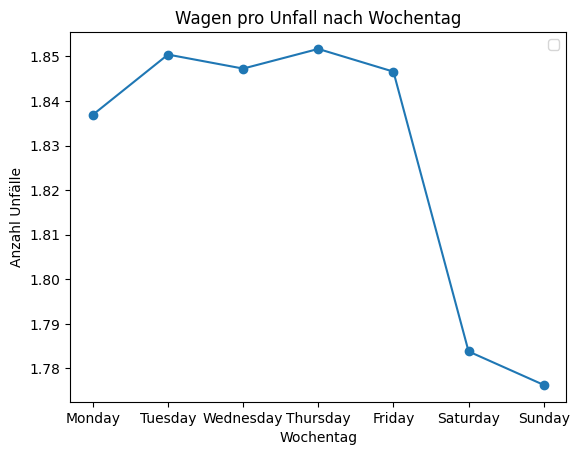

In [ ]:
weekday_mapping = {'Monday': 1, 'Tuesday': 2, 'Wednesday': 3, 'Thursday': 4, 'Friday': 5, 'Saturday': 6, 'Sunday': 7}

sorted_weekdays = sorted(weekday_mapping, key=weekday_mapping.get)

filtered_data = {day: tag2['avg_casualties'][tag2['Day_of_Week'] == day] for day in sorted_weekdays}
x_values = [weekday_mapping[day] for day in sorted_weekdays]

y_values = [filtered_data[day].mean() for day in sorted_weekdays]

plt.plot(x_values, y_values, marker='o', linestyle='-')
plt.xticks(x_values, sorted_weekdays) 
plt.xlabel('Wochentag')
plt.ylabel('Anzahl Unfälle')
plt.title('Wagen pro Unfall nach Wochentag')
plt.legend()
plt.show()

In [ ]:
control2_sum = data.groupby('Junction_Control')['Number_of_Vehicles'].sum().reset_index()
control2_zeile = data['Junction_Control'].value_counts().reset_index()
control2_zeile.columns = ['Junction_Control', 'row_count']
control2 = pd.merge(control2_sum, control2_zeile, on='Junction_Control')
control2['avg_casualties'] = control2['Number_of_Vehicles'] / control2['row_count']
#print(control2)

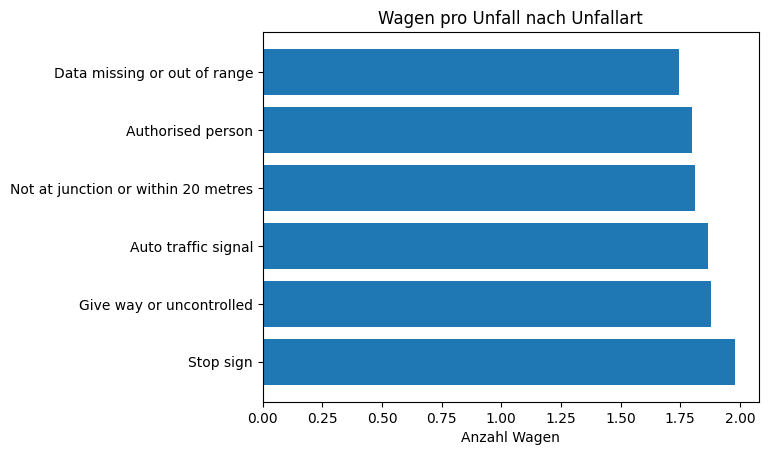

In [ ]:
sorted_control2 = control2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_control2['Junction_Control'], sorted_control2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Unfallart')  
plt.show()

In [ ]:
detail2_sum = data.groupby('Junction_Detail')['Number_of_Vehicles'].sum().reset_index()
detail2_zeile = data['Junction_Detail'].value_counts().reset_index()
detail2_zeile.columns = ['Junction_Detail', 'row_count']
detail2 = pd.merge(detail2_sum, detail2_zeile, on='Junction_Detail')
detail2['avg_casualties'] = detail2['Number_of_Vehicles'] / detail2['row_count']
#print(detail2)

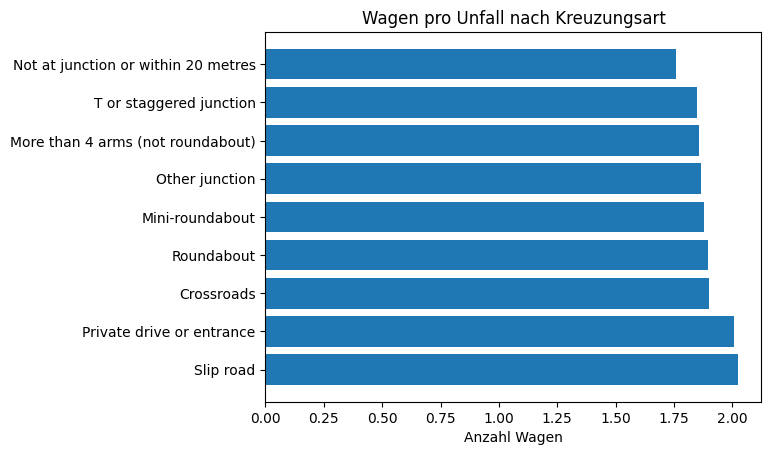

In [ ]:
sorted_detail2 = detail2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_detail2['Junction_Detail'], sorted_detail2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Kreuzungsart')  
plt.show()

In [ ]:
schwer2_sum = data.groupby('Accident_Severity')['Number_of_Vehicles'].sum().reset_index()
schwer2_zeile = data['Accident_Severity'].value_counts().reset_index()
schwer2_zeile.columns = ['Accident_Severity', 'row_count']
schwer2 = pd.merge(schwer2_sum, schwer2_zeile, on='Accident_Severity')
schwer2['avg_casualties'] = schwer2['Number_of_Vehicles'] / schwer2['row_count']
#print(schwer2)

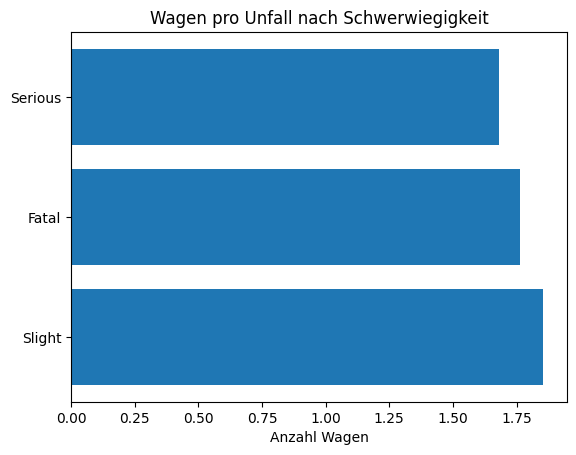

In [ ]:
sorted_schwer2 = schwer2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_schwer2['Accident_Severity'], sorted_schwer2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Schwerwiegigkeit')  
plt.show()

In [ ]:
polizei2_sum = data.groupby('Police_Force')['Number_of_Vehicles'].sum().reset_index()
polizei2_zeile = data['Police_Force'].value_counts().reset_index()
polizei2_zeile.columns = ['Police_Force', 'row_count']
polizei2 = pd.merge(polizei2_sum, polizei2_zeile, on='Police_Force')
polizei2['avg_casualties'] = polizei2['Number_of_Vehicles'] / polizei2['row_count']
#print(polizei2)

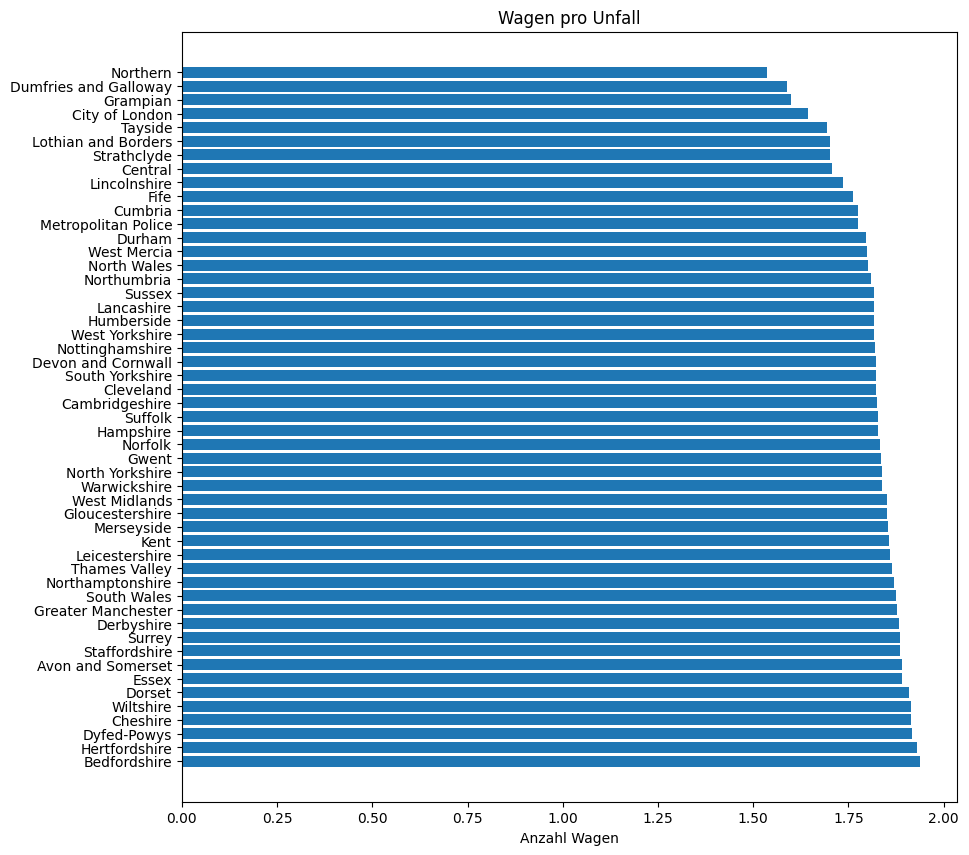

In [ ]:
sorted_polizei2 = polizei2.sort_values(by='avg_casualties', ascending=False)
plt.figure(figsize=(10, 10))
plt.barh(sorted_polizei2['Police_Force'], sorted_polizei2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall') 
plt.show()

In [ ]:
naesse2_sum = data.groupby('Road_Surface_Conditions')['Number_of_Vehicles'].sum().reset_index()
naesse2_zeile = data['Road_Surface_Conditions'].value_counts().reset_index()
naesse2_zeile.columns = ['Road_Surface_Conditions', 'row_count']
naesse2 = pd.merge(naesse2_sum, naesse2_zeile, on='Road_Surface_Conditions')
naesse2['avg_casualties'] = naesse2['Number_of_Vehicles'] / naesse2['row_count']
#print(naesse2)

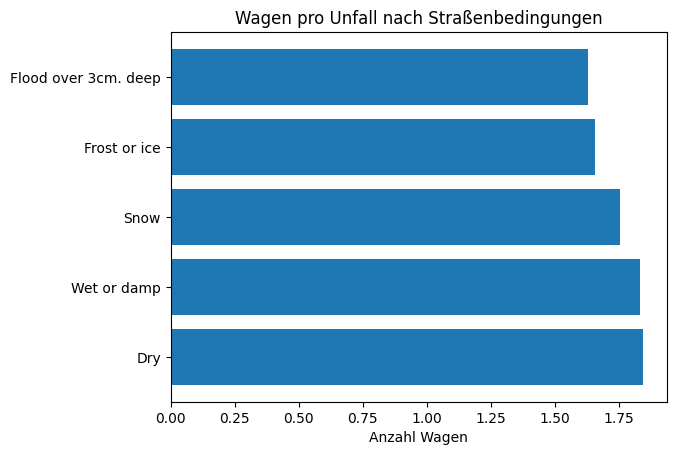

In [ ]:
sorted_naesse2 = naesse2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_naesse2['Road_Surface_Conditions'], sorted_naesse2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Straßenbedingungen') 
plt.show()

In [ ]:
strasse2_sum = data.groupby('Road_Type')['Number_of_Vehicles'].sum().reset_index()
strasse2_zeile = data['Road_Type'].value_counts().reset_index()
strasse2_zeile.columns = ['Road_Type', 'row_count']
strasse2 = pd.merge(strasse2_sum, strasse2_zeile, on='Road_Type')
strasse2['avg_casualties'] = strasse2['Number_of_Vehicles'] / strasse2['row_count']
#print(strasse2)

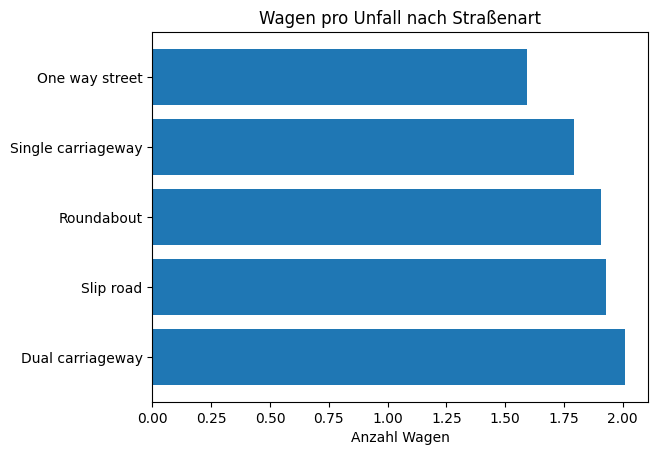

In [ ]:
sorted_strasse2 = strasse2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_strasse2['Road_Type'], sorted_strasse2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Straßenart') 
plt.show()

In [ ]:
speed2_sum = data.groupby('Speed_limit')['Number_of_Vehicles'].sum().reset_index()
speed2_zeile = data['Speed_limit'].value_counts().reset_index()
speed2_zeile.columns = ['Speed_limit', 'row_count']
speed2 = pd.merge(speed2_sum, speed2_zeile, on='Speed_limit')
speed2['avg_casualties'] = speed2['Number_of_Vehicles'] / speed2['row_count']
#print(speed2)

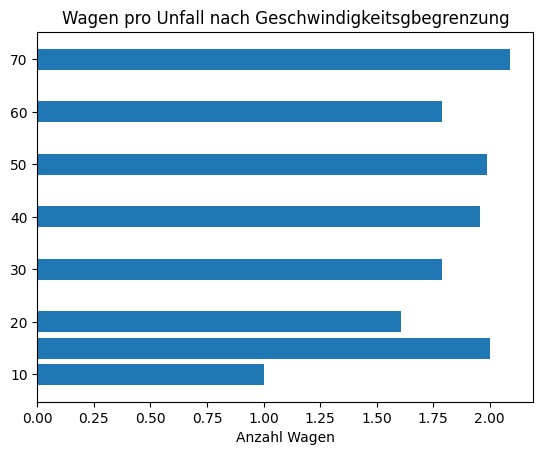

In [ ]:
plt.barh(speed2['Speed_limit'], speed2['avg_casualties'], height=4)
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Geschwindigkeitsgbegrenzung') 
plt.show()

In [ ]:
ur2_sum = data.groupby('Urban_or_Rural_Area')['Number_of_Vehicles'].sum().reset_index()
ur2_zeile = data['Urban_or_Rural_Area'].value_counts().reset_index()
ur2_zeile.columns = ['Urban_or_Rural_Area', 'row_count']
ur2 = pd.merge(ur2_sum, ur2_zeile, on='Urban_or_Rural_Area')
ur2['avg_casualties'] = ur2['Number_of_Vehicles'] / ur2['row_count']
#print(ur2)

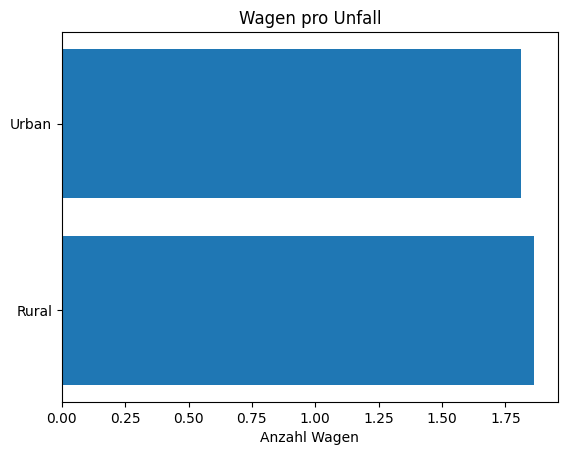

In [ ]:
plt.barh(ur2['Urban_or_Rural_Area'], ur2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall') 
plt.show()

In [ ]:
wetter2_sum = data.groupby('Weather_Conditions')['Number_of_Vehicles'].sum().reset_index()
wetter2_zeile = data['Weather_Conditions'].value_counts().reset_index()
wetter2_zeile.columns = ['Weather_Conditions', 'row_count']
wetter2 = pd.merge(wetter2_sum, wetter2_zeile, on='Weather_Conditions')
wetter2['avg_casualties'] = wetter2['Number_of_Vehicles'] / wetter2['row_count']
#print(wetter2)

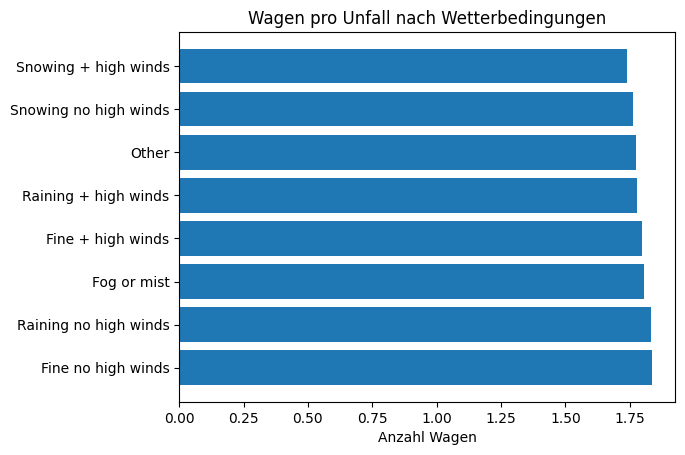

In [ ]:
sorted_wetter2 = wetter2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_wetter2['Weather_Conditions'], sorted_wetter2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Wetterbedingungen') 
plt.show()

In [ ]:
auto2_sum = data.groupby('Vehicle_Type')['Number_of_Vehicles'].sum().reset_index()
auto2_zeile = data['Vehicle_Type'].value_counts().reset_index()
auto2_zeile.columns = ['Vehicle_Type', 'row_count']
auto2 = pd.merge(auto2_sum, auto2_zeile, on='Vehicle_Type')
auto2['avg_casualties'] = auto2['Number_of_Vehicles'] / auto2['row_count']
#print(auto2)

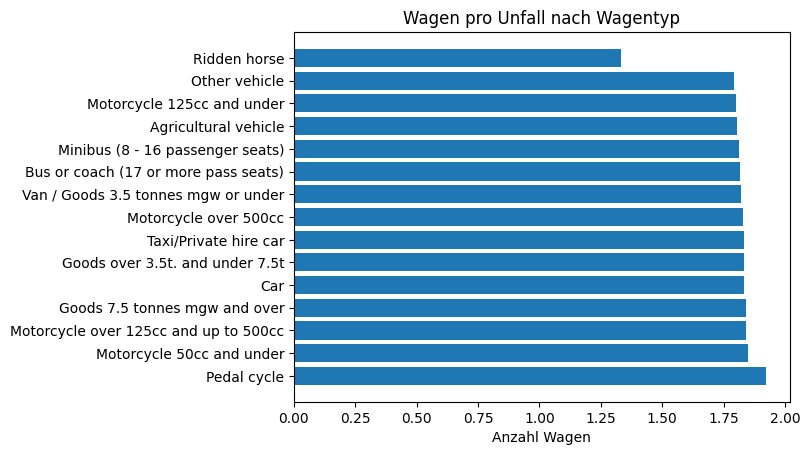

In [ ]:
sorted_auto2 = auto2.sort_values(by='avg_casualties', ascending=False)
plt.barh(sorted_auto2['Vehicle_Type'], sorted_auto2['avg_casualties'])
plt.xlabel('Anzahl Wagen')
plt.title('Wagen pro Unfall nach Wagentyp') 
plt.show()

Zeitlich

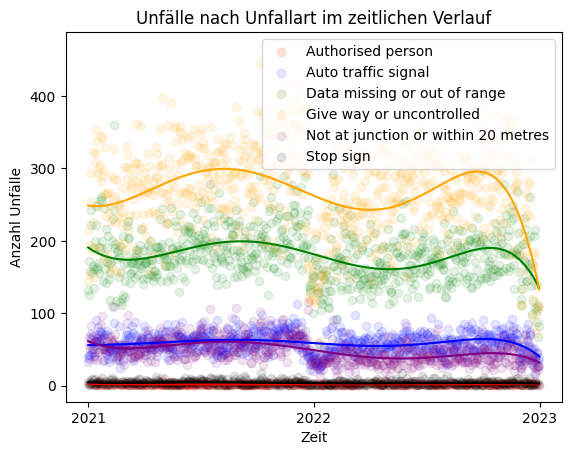

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple', 'black']
b_group = agr =data.groupby(['Junction_Control', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Junction_Control, group_data) in enumerate(b_group.groupby('Junction_Control')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Junction_Control, alpha=0.1, color=color)

    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 6) 
    trendline = np.poly1d(coefficients)(x)

    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Unfälle nach Unfallart im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

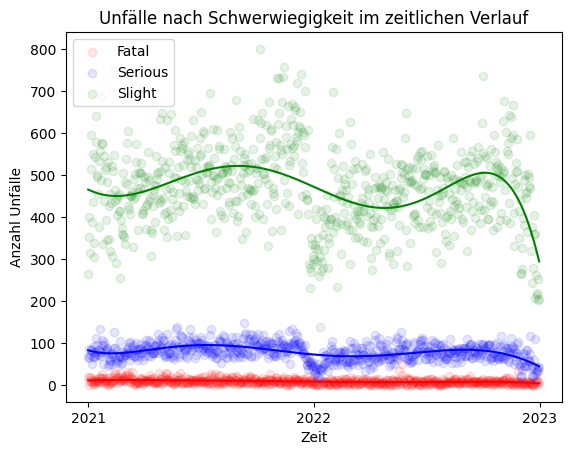

In [ ]:
colors = ['red', 'blue', 'green']
d_group =data.groupby(['Accident_Severity', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Accident_Severity, group_data) in enumerate(d_group.groupby('Accident_Severity')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Accident_Severity, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 6) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Unfälle nach Schwerwiegigkeit im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

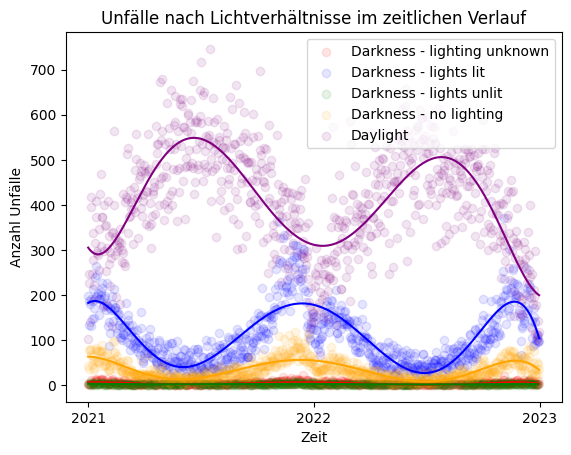

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple']
e_group =data.groupby(['Light_Conditions', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Light_Conditions, group_data) in enumerate(e_group.groupby('Light_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Light_Conditions, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 6) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Unfälle nach Lichtverhältnisse im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

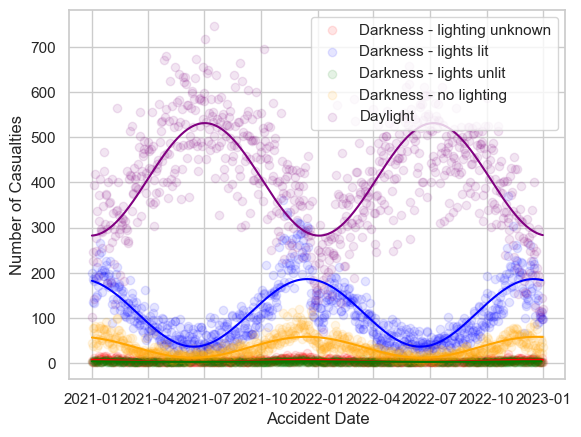

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy.optimize

# Define the sinusoidal function
def sinus_function(x, amplitude, period, phase_shift, vertical_shift):
    return amplitude * np.sin(2 * np.pi * x / period + phase_shift) + vertical_shift

colors = ['red', 'blue', 'green', 'orange', 'purple']

# Group the data
e_group = data.groupby(['Light_Conditions', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()

# Plot for each light condition group
for i, (Light_Conditions, group_data) in enumerate(e_group.groupby('Light_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Light_Conditions, alpha=0.1, color=color)

    # x-values as time points in months since the start date
    start_year = group_data['Accident Date'].dt.year.min()  # Get the start year of the data
    x = np.arange(len(group_data)) + start_year  # Adjust x-values to start from the actual start year
    
    # y-values as number of casualties
    y = group_data['Number_of_Casualties']
    vertical_shift = y.mean()
    p0 = [max(y) - min(y), len(y)/(3/2), 0, vertical_shift]  # Initial guess for amplitude, period, phase shift, and vertical shift
    # Fit the sinusoidal function to the data
    params, _ = scipy.optimize.curve_fit(sinus_function, x, y, p0=p0)
    # Generate the trendline using the fitted parameters
    trendline = sinus_function(x, *params)
    
    # Plot the trendline
    plt.plot(group_data['Accident Date'], trendline, color=color)

    # Extend the trendline to the right by one amplitude, but only until 2024
    x_extended = np.arange(len(group_data), len(group_data) + params[1])  # Add one period to the x-values
    x_extended = x_extended[x_extended + start_year <= 2025]  # Limit extension to the year 2024
    trendline_extended = sinus_function(x_extended, *params)
    # Convert the integer array representing months to a Timedelta object and add it to the last timestamp
    extended_dates = group_data['Accident Date'].iloc[-1] + pd.DateOffset(months=1) * np.arange(1, len(x_extended) + 1)
    plt.plot(extended_dates, trendline_extended, linestyle='--', color=color)

plt.xlabel('Accident Date')
plt.ylabel('Number of Casualties')
plt.legend()
plt.show()


C:\Users\vanes\AppData\Local\Temp\ipykernel_776\3181171244.py:25: FutureWarning: Non-integer 'periods' in pd.date_range, pd.timedelta_range, pd.period_range, and pd.interval_range are deprecated and will raise in a future version.
  extended_x = pd.date_range(start=last_date, periods=len(group_data)/24 +12, freq='W')


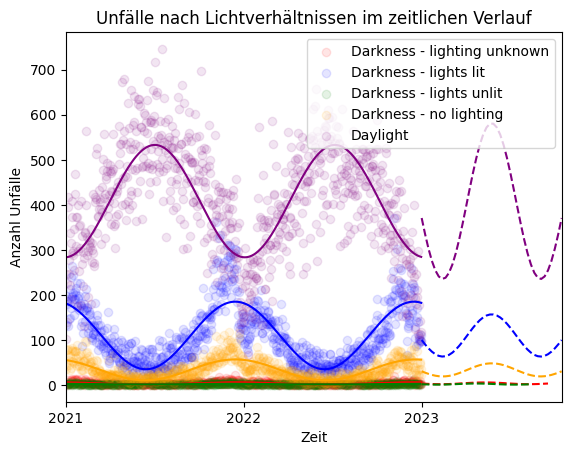

In [ ]:
# Plot für jede Lichtverhältnisgruppe
for i, (Light_Conditions, group_data) in enumerate(e_group.groupby('Light_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Light_Conditions, alpha=0.1, color=color)

    # x-Werte als Zeitpunkte in Monaten seit dem Startdatum
    x = np.arange(len(group_data))  
    
    # y-Werte als Anzahl der Unfälle
    y = group_data['Number_of_Casualties']
    vertical_shift = y.mean()
    
    # Sinus-Approximation der Trendlinie
    trendline = sinus_approximation(x, y, vertical_shift)
    
    # Plot der Sinus-Trendlinie
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)
    
    # Plot-Bereich um ein Jahr erweitern (rechts vom ursprünglichen Graphen)
    extended_x = np.arange(len(group_data), len(group_data) + 12)
    
   # Erweiterte X-Werte (basierend auf der Länge der erweiterten Daten)
    last_date = group_data['Accident Date'].iloc[-1]
    #extended_x = pd.date_range(start=last_date, periods=len(group_data), freq='M')  # 12 Monate für den ursprünglichen Graphen und weitere 12 Monate für die Fortsetzung
    extended_x = pd.date_range(start=last_date, periods=len(group_data)/24 +12, freq='W')
    # Erweiterte Y-Werte mit Nullen für die zusätzlichen Monate
    extended_y = np.zeros(len(extended_x))

    # Sinus-Approximation der Trendlinie für den erweiterten Bereich
    trendline_extended = sinus_approximation(np.arange(len(extended_x)), extended_y, vertical_shift)

    # Plot der Sinus-Trendlinie für den erweiterten Bereich
    plt.plot(extended_x, trendline_extended, linestyle='--', color=color)

# Titel und Beschriftungen
plt.title('Unfälle nach Lichtverhältnissen im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.xlim(group_data['Accident Date'].iloc[0], extended_x[-1])
plt.show()


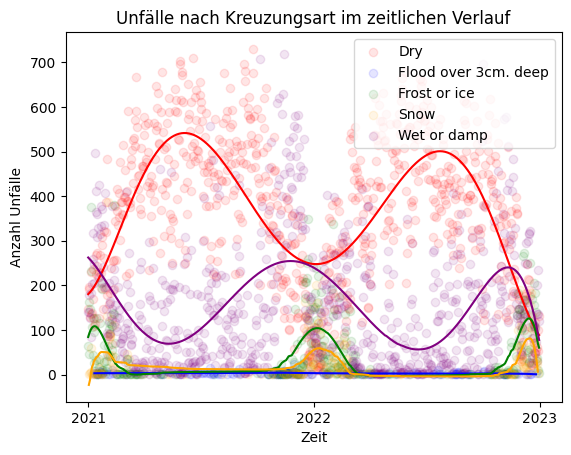

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple']
j_group =data.groupby(['Road_Surface_Conditions', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Road_Surface_Conditions, group_data) in enumerate(j_group.groupby('Road_Surface_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Road_Surface_Conditions, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 6) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Unfälle nach Kreuzungsart im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

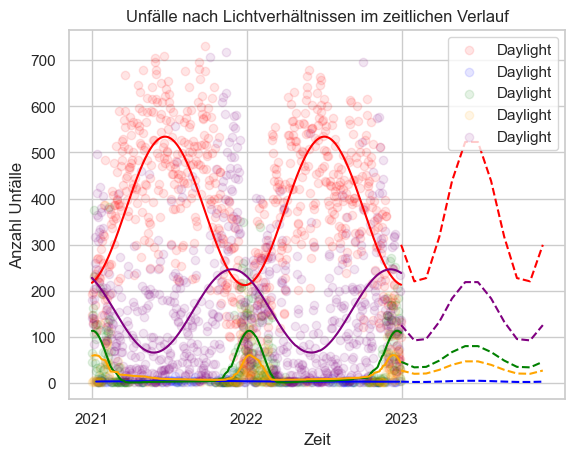

In [ ]:
# Plot für jede Lichtverhältnisgruppe
# Sinus-Approximationsfunktion
def sinus_approximation(x, y, vertical_shift):
    # Sinusfunktion mit variabler Periode und Amplitude
    def sinus_function(x, amplitude, period, phase_shift):
        return amplitude * np.sin(2 * np.pi * x / period + phase_shift) + vertical_shift
    
    # Anfangsschätzung für Amplitude, Periode und Phasenverschiebung
    p0 = [max(y) - min(y), len(y)/(3/2) , 0]  # Annahme: Amplitude ist die Differenz zwischen dem größten und dem kleinsten y-Wert
    a = max(y) - max(x)
    # Fit der Sinusfunktion an die Daten
    params, _ = scipy.optimize.curve_fit(sinus_function, x, y, p0=p0)
    
    # Rückgabe der approximierten y-Werte
    return sinus_function(x, *params)

# Farben für die Plot-Linien
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Daten gruppieren
i_group = data.groupby(['Road_Surface_Conditions', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Road_Surface_Conditions, group_data) in enumerate(i_group.groupby('Road_Surface_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Light_Conditions, alpha=0.1, color=color)

    # x-Werte als Zeitpunkte in Monaten seit dem Startdatum
    x = np.arange(len(group_data))  
    
    # y-Werte als Anzahl der Unfälle
    y = group_data['Number_of_Casualties']
    vertical_shift = y.mean()
    
    # Sinus-Approximation der Trendlinie
    trendline = sinus_approximation(x, y, vertical_shift)
    
    # Plot der Sinus-Trendlinie
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)
    
    # Plot-Bereich um ein Jahr erweitern (rechts vom ursprünglichen Graphen)
    extended_x = np.arange(len(group_data), len(group_data) + 12)
    
    # Erweiterte Y-Werte mit Nullen für die zusätzlichen Monate
    extended_y = np.zeros(12)
    
    # Sinus-Approximation der Trendlinie für den erweiterten Bereich
    trendline_extended = sinus_approximation(extended_x, extended_y, vertical_shift)
    
    # Erweiterte Zeitstempel generieren
    extended_dates = pd.date_range(start=group_data['Accident Date'].iloc[-1], periods=12, freq='ME')
    
    # Plot der Sinus-Trendlinie für den erweiterten Bereich
    plt.plot(extended_dates, trendline_extended, linestyle='--', color=color)

# Titel und Beschriftungen
plt.title('Unfälle nach Lichtverhältnissen im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

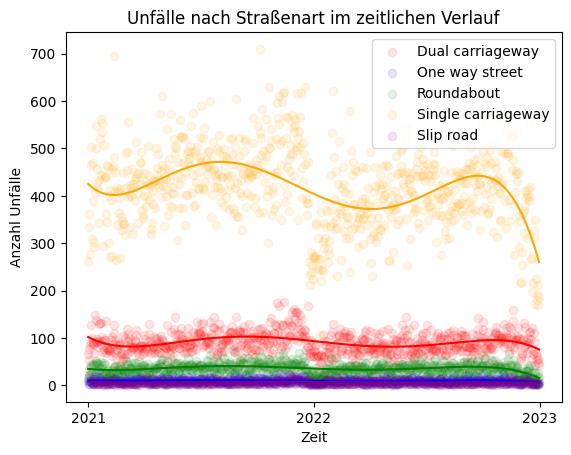

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple']
k_group =data.groupby(['Road_Type', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Road_Type, group_data) in enumerate(k_group.groupby('Road_Type')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Road_Type, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 5) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Unfälle nach Straßenart im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

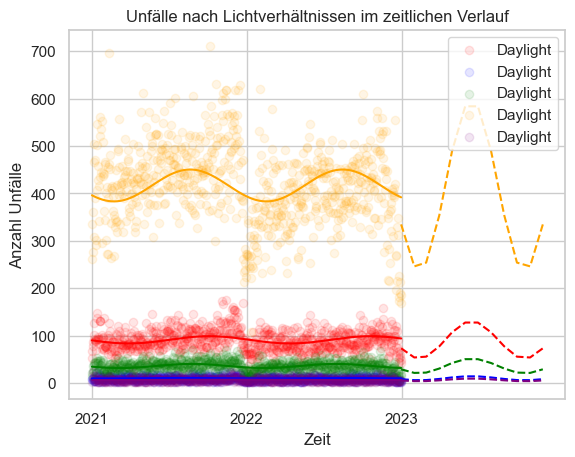

In [ ]:
# Plot für jede Lichtverhältnisgruppe
# Sinus-Approximationsfunktion
def sinus_approximation(x, y, vertical_shift):
    # Sinusfunktion mit variabler Periode und Amplitude
    def sinus_function(x, amplitude, period, phase_shift):
        return amplitude * np.sin(2 * np.pi * x / period + phase_shift) + vertical_shift
    
    # Anfangsschätzung für Amplitude, Periode und Phasenverschiebung
    p0 = [max(y) - min(y), len(y)/(3/2) , 0]  # Annahme: Amplitude ist die Differenz zwischen dem größten und dem kleinsten y-Wert
    a = max(y) - max(x)
    # Fit der Sinusfunktion an die Daten
    params, _ = scipy.optimize.curve_fit(sinus_function, x, y, p0=p0)
    
    # Rückgabe der approximierten y-Werte
    return sinus_function(x, *params)

# Farben für die Plot-Linien
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Daten gruppieren
k_group = data.groupby(['Road_Type', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Road_Surface_Conditions, group_data) in enumerate(k_group.groupby('Road_Type')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Light_Conditions, alpha=0.1, color=color)

    # x-Werte als Zeitpunkte in Monaten seit dem Startdatum
    x = np.arange(len(group_data))  
    
    # y-Werte als Anzahl der Unfälle
    y = group_data['Number_of_Casualties']
    vertical_shift = y.mean()
    
    # Sinus-Approximation der Trendlinie
    trendline = sinus_approximation(x, y, vertical_shift)
    
    # Plot der Sinus-Trendlinie
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)
    
    # Plot-Bereich um ein Jahr erweitern (rechts vom ursprünglichen Graphen)
    extended_x = np.arange(len(group_data), len(group_data) + 12)
    
    # Erweiterte Y-Werte mit Nullen für die zusätzlichen Monate
    extended_y = np.zeros(12)
    
    # Sinus-Approximation der Trendlinie für den erweiterten Bereich
    trendline_extended = sinus_approximation(extended_x, extended_y, vertical_shift)
    
    # Erweiterte Zeitstempel generieren
    extended_dates = pd.date_range(start=group_data['Accident Date'].iloc[-1], periods=12, freq='ME')
    
    # Plot der Sinus-Trendlinie für den erweiterten Bereich
    plt.plot(extended_dates, trendline_extended, linestyle='--', color=color)

# Titel und Beschriftungen
plt.title('Unfälle nach Lichtverhältnissen im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

TypeError: sinus_approximation.<locals>.sinus_function() missing 1 required positional argument: 'vertical_shift'

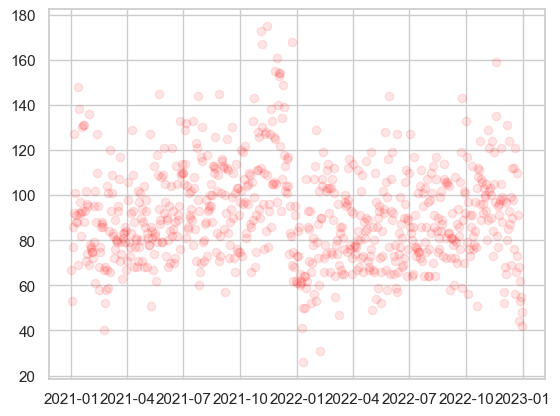

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.optimize

# Sinus-Approximationsfunktion
def sinus_approximation(x, y, vertical_shift):
    # Sinusfunktion mit variabler Periode und Amplitude
    def sinus_function(x, amplitude, period, phase_shift, vertical_shift):
        return amplitude * np.sin(2 * np.pi * x / period + phase_shift) + vertical_shift
    
    # Anfangsschätzung für Amplitude, Periode und Phasenverschiebung
    p0 = [max(y) - min(y), len(y) / (3/2), 0]  # Annahme: Amplitude ist die Differenz zwischen dem größten und dem kleinsten y-Wert

    # Fit der Sinusfunktion an die Daten
    params, _ = scipy.optimize.curve_fit(sinus_function, x, y, p0=p0)
    
    # Rückgabe der approximierten y-Werte und die optimierten Parameter
    return sinus_function(x, *params), params

# Daten gruppieren
k_group = data.groupby(['Road_Type', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()

# Farben für die Plot-Linien
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Plot für jede Lichtverhältnisgruppe
for i, (Road_Type, group_data) in enumerate(k_group.groupby('Road_Type')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Road_Type, alpha=0.1, color=color)

    # x-Werte als Zeitpunkte in Monaten seit dem Startdatum
    x = np.arange(len(group_data))  
    
    # y-Werte als Anzahl der Unfälle
    y = group_data['Number_of_Casualties']
    vertical_shift = y.mean()
    
    # Sinus-Approximation der Trendlinie und Parameter erhalten
    trendline, params = sinus_approximation(x, y, vertical_shift)
    
    # Plot der Sinus-Trendlinie
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color, label='Trendline')

    # Plot-Bereich um ein Jahr erweitern (rechts vom ursprünglichen Graphen)
    extended_x = np.arange(len(group_data), len(group_data) + 12)
    
    # Erweiterte Y-Werte mit Nullen für die zusätzlichen Monate
    extended_y = sinus_function(extended_x, amplitude, period, phase_shift, vertical_shift):
    
    # Sinus-Approximation der Trendlinie für den erweiterten Bereich mit den gleichen Parametern
    trendline_extended = sinus_approximation(extended_x, extended_y, vertical_shift)[0]
    
    # Erweiterte Zeitstempel generieren
    extended_dates = pd.date_range(start=group_data['Accident Date'].iloc[-1], periods=12, freq='M')
    
    # Plot der Sinus-Trendlinie für den erweiterten Bereich
    plt.plot(extended_dates, sinus_function(extended_x, *params), linestyle='--', color=color)

# Titel und Beschriftungen
plt.title('Unfälle nach Straßentyp im zeitlichen Verlauf')
plt.xlabel('Zeit')
plt.ylabel('Anzahl Unfälle')
plt.legend()
plt.show()


C:\Users\vanes\AppData\Local\Temp\ipykernel_776\3089477260.py:10: RankWarning: Polyfit may be poorly conditioned
  coefficients = np.polyfit(x, y, 5)
C:\Users\vanes\AppData\Local\Temp\ipykernel_776\3089477260.py:10: RankWarning: Polyfit may be poorly conditioned
  coefficients = np.polyfit(x, y, 5)


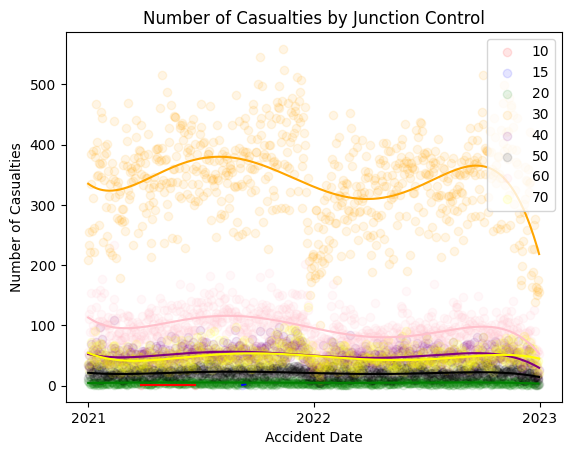

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple', 'black', 'pink', 'yellow']
k_group =data.groupby(['Speed_limit', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Speed_limit, group_data) in enumerate(k_group.groupby('Speed_limit')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Speed_limit, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 5) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Number of Casualties by Junction Control')
plt.xlabel('Accident Date')
plt.ylabel('Number of Casualties')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

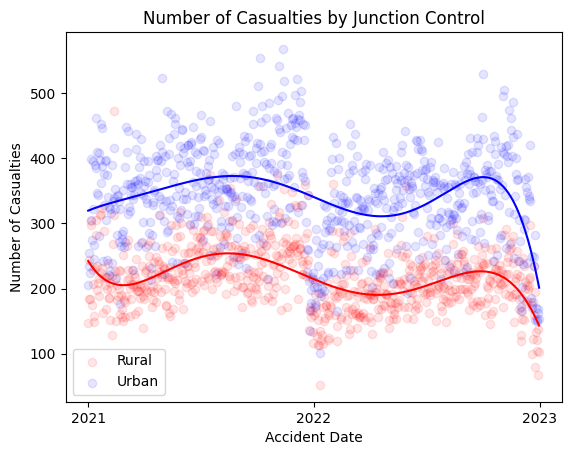

In [ ]:
colors = ['red', 'blue']
k_group =data.groupby(['Urban_or_Rural_Area', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Urban_or_Rural_Area, group_data) in enumerate(k_group.groupby('Urban_or_Rural_Area')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Urban_or_Rural_Area, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 6) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Number of Casualties by Junction Control')
plt.xlabel('Accident Date')
plt.ylabel('Number of Casualties')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

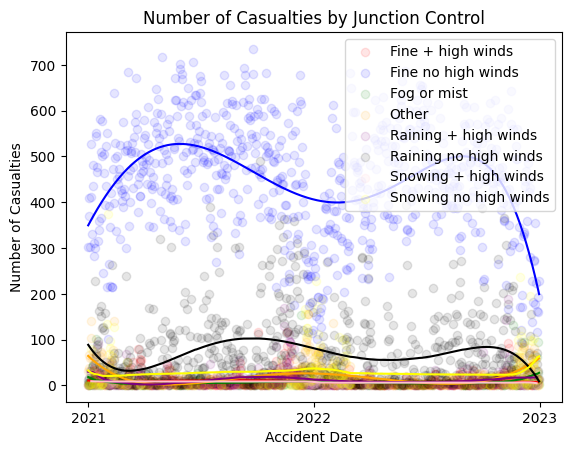

In [ ]:
colors = ['red', 'blue', 'green', 'orange', 'purple', 'black', 'pink', 'yellow']
k_group =data.groupby(['Weather_Conditions', 'Accident Date'])['Number_of_Casualties'].sum().reset_index()
for i, (Weather_Conditions, group_data) in enumerate(k_group.groupby('Weather_Conditions')):
    color = colors[i % len(colors)] 
    plt.scatter(group_data['Accident Date'], group_data['Number_of_Casualties'], label=Weather_Conditions, alpha=0.1, color=color)


    x = np.arange(len(group_data))  
    y = group_data['Number_of_Casualties']
    coefficients = np.polyfit(x, y, 5) 
    trendline = np.poly1d(coefficients)(x)
    plt.plot(group_data['Accident Date'], trendline, linestyle='-', color=color)

plt.title('Number of Casualties by Junction Control')
plt.xlabel('Accident Date')
plt.ylabel('Number of Casualties')
x_ticks = [pd.Timestamp('2021-01-01'), pd.Timestamp('2022-01-01'), pd.Timestamp('2023-01-01')]
x_labels = ['2021', '2022', '2023']
plt.xticks(x_ticks, x_labels)
plt.legend()
plt.show()

Geographie

In [ ]:
mittel1 = data['Latitude'].mean()
mittel2 = data['Longitude'].mean()
karte = fl.Map(location = [mittel1, mittel2], zoom_start = 6, control_scale=True,)
os.makedirs('Karten', exist_ok=True)
karte.save
karte

In [ ]:
lat_long = data[['Latitude', 'Longitude']].values.tolist()
karte2 = fl.Map(location = [mittel1, mittel2], zoom_start = 6, control_scale=True,)
HeatMap(lat_long, radius=(30), blur=(28),).add_to(karte2)
karte2.save
karte2

In [ ]:
filtered_data = data[(data['Local_Authority_(District)'] == 'Kensington and Chelsea')]
lat_long = filtered_data[['Latitude', 'Longitude']].values.tolist()
karte3 = fl.Map(location = [mittel1, mittel2], zoom_start = 6, control_scale=True,)
os.makedirs('Karten', exist_ok=True)
HeatMap(lat_long, radius=(30), blur=(28),).add_to(karte3)
karte3


In [ ]:
karte4 = fl.Map(location=[mittel1, mittel2], zoom_start=11, control_scale=True)

# Kategorien auswählen
kategorien = data['Accident_Severity'].unique()

# Farben für jede Kategorie definieren
farben = ['red', 'green', 'blue']

# Karte für jede Kategorie erstellen und zur Hauptkarte hinzufügen
for kategorie, farbe in zip(kategorien, farben):
    # Daten für die aktuelle Kategorie filtern
    filtered_data = data[data['Accident_Severity'] == kategorie]
    
    # Koordinaten aus den gefilterten Daten extrahieren
    lat_long = filtered_data[['Latitude', 'Longitude']].values.tolist()
    
    # Heatmap für die aktuelle Kategorie erstellen und zur Hauptkarte hinzufügen
    HeatMap(lat_long, gradient={0.1: 'transparent', 0.65: farbe}).add_to(karte4)

karte4.save
karte4

In [ ]:
import plotly.express as px

fig = px.scatter_mapbox(data, lat="Latitude", lon="Longitude", color="Light_Conditions",
                        color_continuous_scale="Viridis",
                        size_max=15, zoom=3)

fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<Axes: xlabel='Number_of_Casualties', ylabel='Light_Conditions'>

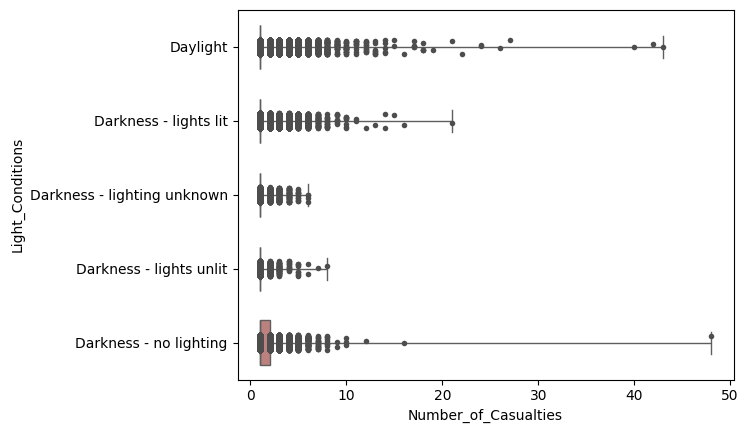

In [ ]:
sns.boxplot(
    data=data, x="Number_of_Casualties", y="Light_Conditions", hue="Light_Conditions",
    whis=[0, 100], width=.6, palette="vlag"
)
sns.stripplot(data=data, x="Number_of_Casualties", y="Light_Conditions", size=4, color=".3")

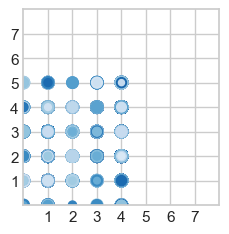

In [315]:
import matplotlib.pyplot as plt
import numpy as np

plt.style.use('_mpl-gallery')

x = encoded_data['Light_Conditions_Encoded']
y = encoded_data['Junction_Control_Encoded']
# size and color:
sizes = np.random.uniform(15, 80, len(x))
colors = np.random.uniform(15, 80, len(x))

# plot
fig, ax = plt.subplots()

ax.scatter(x, y, s=sizes, c=colors, vmin=0, vmax=100)

ax.set(xlim=(0, 8), xticks=np.arange(1, 8),
       ylim=(0, 8), yticks=np.arange(1, 8))

plt.show()

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123

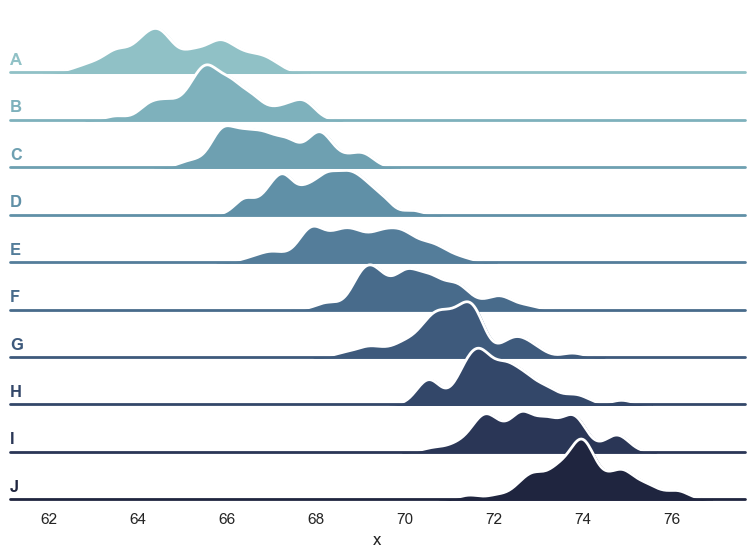

In [316]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Create the data
rs = np.random.RandomState(1979)
x = rs.randn(500)
g = np.tile(list("ABCDEFGHIJ"), 50)
df = pd.DataFrame(dict(x=x, g=g))
m = df.g.map(ord)
df["x"] += m

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(df, row="g", hue="g", aspect=15, height=.5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "x",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "x", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "x")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
# Scatterplot erstellen
plt.scatter(data['Junction_Control_Encoded'], data['Light_Conditions'])

# Achsenbeschriftungen hinzufügen
plt.xlabel('X-Achse')
plt.ylabel('Y-Achse')

# Plot anzeigen
plt.show()

NameError: name 'data' is not defined

C:\Users\vanes\AppData\Local\Temp\ipykernel_16868\558329063.py:5: UserWarning: 
The palette list has fewer values (1) than needed (7) and will cycle, which may produce an uninterpretable plot.
  g = sns.relplot(


ValueError: Invalid RGBA argument: <matplotlib.colors.ListedColormap object at 0x000002162F2F0950>

Error in callback <function _draw_all_if_interactive at 0x0000021604B0CFE0> (for post_execute), with arguments args (),kwargs {}:


ValueError: Invalid RGBA argument: <matplotlib.colors.ListedColormap object at 0x000002162F2F0950>

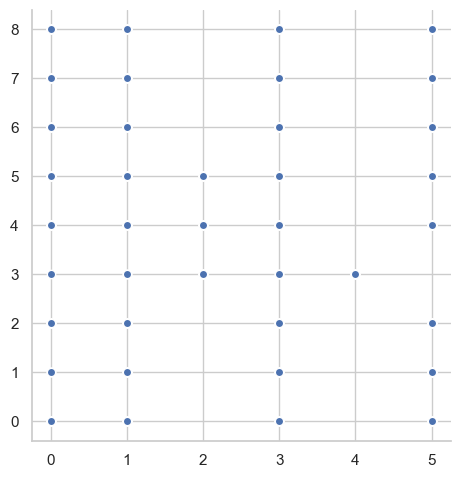

In [309]:
import seaborn as sns
sns.set_theme(style="whitegrid")

cmap = sns.cubehelix_palette(rot=-.2, as_cmap=True)
g = sns.relplot(
    data = encoded_data,
    x="Junction_Control_Encoded", y="Junction_Detail_Encoded",
    hue="Day_of_Week_Encoded", size="Number_of_Vehicles",
    palette = [cmap], sizes=(10, 200),
)
g.set(xscale="log", yscale="log")
g.ax.xaxis.grid(True, "minor", linewidth=.25)
g.ax.yaxis.grid(True, "minor", linewidth=.25)
g.despine(left=True, bottom=True)

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\

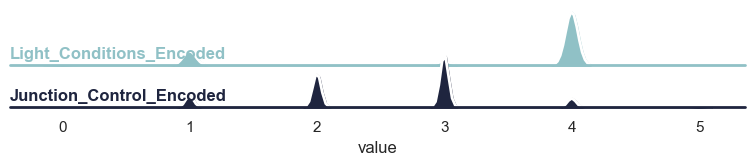

In [326]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Annahme: DataFrame data enthält die Daten
# Ersetze "Spalte1" und "Spalte2" durch die tatsächlichen Spaltennamen in deiner Tabelle
spalten = encoded_data[['Light_Conditions_Encoded', 'Junction_Control_Encoded']].copy()

# Initialisieren des FacetGrid-Objekts
pal = sns.cubehelix_palette(2, rot=-.25, light=.7)  # Farbpalette für die beiden Spalten
g = sns.FacetGrid(spalten.melt(), row="variable", hue="variable", aspect=15, height=.5, palette=pal)

# Kernedichteabschätzungen zeichnen
g.map(sns.kdeplot, "value", bw_adjust=.5, clip_on=False, fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "value", clip_on=False, color="w", lw=2, bw_adjust=.5)

# Referenzlinie hinzufügen
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)

# Beschriftung hinzufügen
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
g.map(label, "value")

# Überlappung der Subplots festlegen
g.figure.subplots_adjust(hspace=-.25)

# Achsendetails entfernen
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

plt.show()


c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.

c:\Users\vanes\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:123

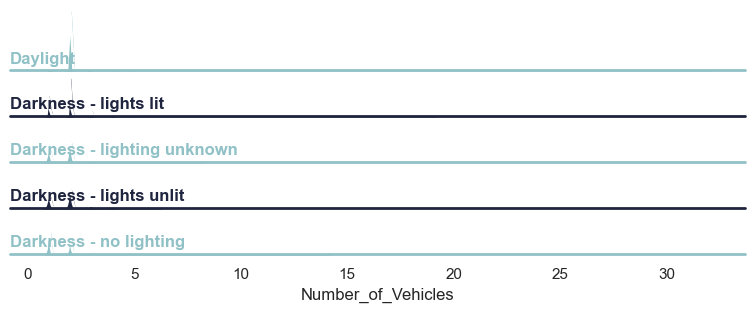

In [329]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Annahme: DataFrame data enthält die Daten
# Ersetze "Spalte1" und "Spalte2" durch die tatsächlichen Spaltennamen in deiner Tabelle
spalten = data[['Light_Conditions', 'Number_of_Vehicles']].copy()

# Initialisieren des FacetGrid-Objekts
pal = sns.cubehelix_palette(2, rot=-.25, light=.7)  # Farbpalette für die beiden Spalten
g = sns.FacetGrid(spalten, row="Light_Conditions", hue="Light_Conditions", aspect=15, height=.5, palette=pal)

# Kernedichteabschätzungen zeichnen
g.map(sns.kdeplot, "Number_of_Vehicles", bw_adjust=.5, clip_on=False, fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "Number_of_Vehicles", clip_on=False, color="w", lw=2, bw_adjust=.5)

# Referenzlinie hinzufügen
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)

# Beschriftung hinzufügen
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
g.map(label, "Number_of_Vehicles")

# Überlappung der Subplots festlegen
g.figure.subplots_adjust(hspace=-.25)

# Achsendetails entfernen
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

plt.show()


    Light_Conditions_Encoded  Junction_Control_Encoded  frequency
0                          0                         0          4
1                          0                         1        162
2                          0                         2        879
3                          0                         3       1014
4                          0                         4        137
5                          0                         5         20
6                          1                         0         80
7                          1                         1       8983
8                          1                         2      16017
9                          1                         3      30132
10                         1                         4       3516
11                         1                         5        281
12                         2                         0          1
13                         2                         1         95
14        

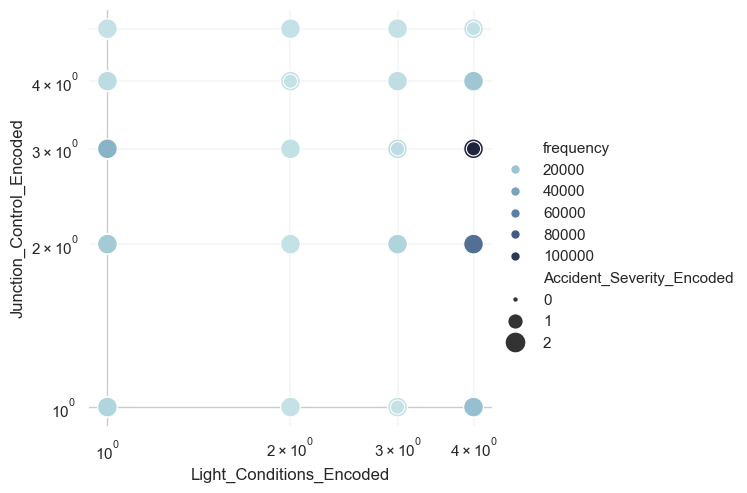

In [354]:
import seaborn as sns
sns.set_theme(style="whitegrid")
frequency = encoded_data.groupby(['Light_Conditions_Encoded', 'Junction_Control_Encoded']).size().reset_index(name='frequency')
print(frequency)
data_with_frequency = pd.merge(encoded_data, frequency, on=['Light_Conditions_Encoded', 'Junction_Control_Encoded'])
cmap = sns.cubehelix_palette(rot=-.2, as_cmap=True)
g = sns.relplot(
    data=data_with_frequency,
    x="Light_Conditions_Encoded", y="Junction_Control_Encoded",
    hue="frequency", size="Accident_Severity_Encoded",
    palette=cmap, sizes=(10, 200),
)
g.set(xscale="log", yscale="log")
g.ax.xaxis.grid(True, "minor", linewidth=.25)
g.ax.yaxis.grid(True, "minor", linewidth=.25)
g.despine(left=True, bottom=True)

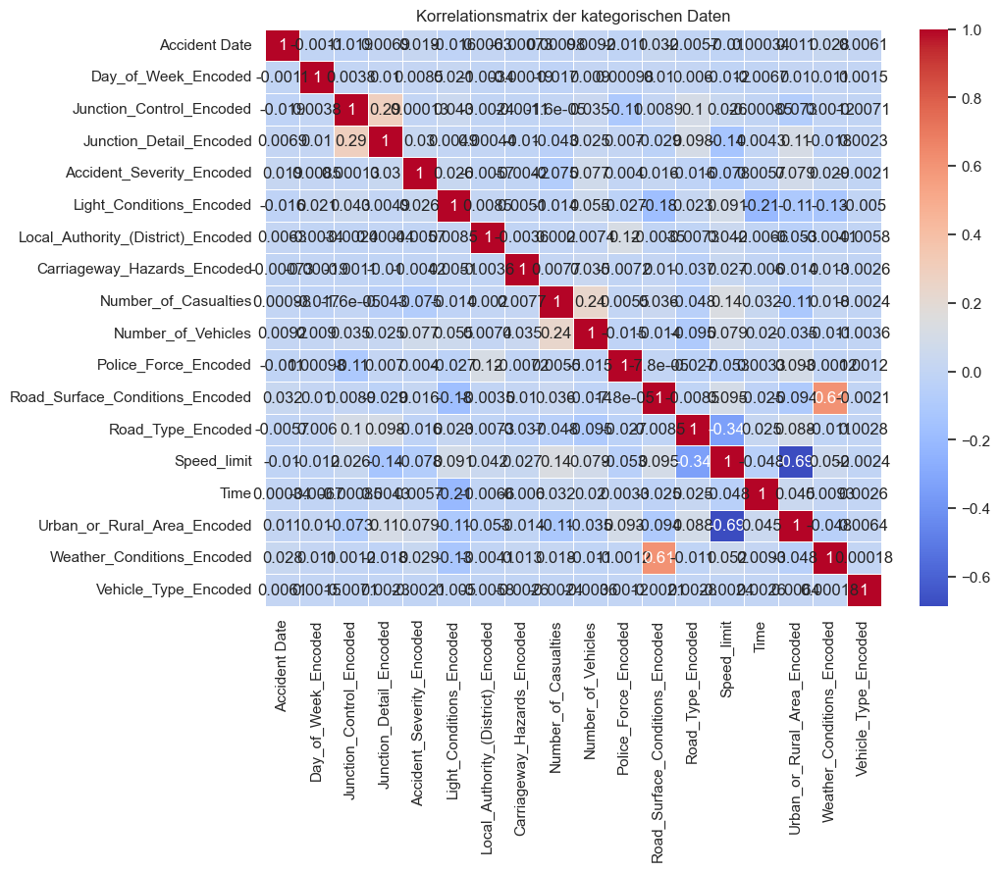

In [346]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt



# Berechne die Korrelationsmatrix
correlation_matrix = encoded_data.corr()

# Erstelle eine Heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Korrelationsmatrix der kategorischen Daten')
plt.show()

In [376]:
import plotly.graph_objects as go
selected_columns = ['Junction_Control_Encoded', 'Road_Type_Encoded']

# Korrelationsmatrix für die ausgewählten Spalten berechnen
correlation_matrix = df[selected_columns].corr()

# Plotly Heatmap erstellen
fig = go.Figure(data=go.Heatmap(
                   z=correlation_matrix.values,
                   x=selected_columns,
                   y=selected_columns,
                   hoverongaps=False))
fig.show()

In [378]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
                   z=[[1, None, 30, 50, 1], [20, 1, 60, 80, 30], [30, 60, 1, -10, 20]],
                   x=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'],
                   y=['Morning', 'Afternoon', 'Evening'],
                   hoverongaps = False))
fig.show()

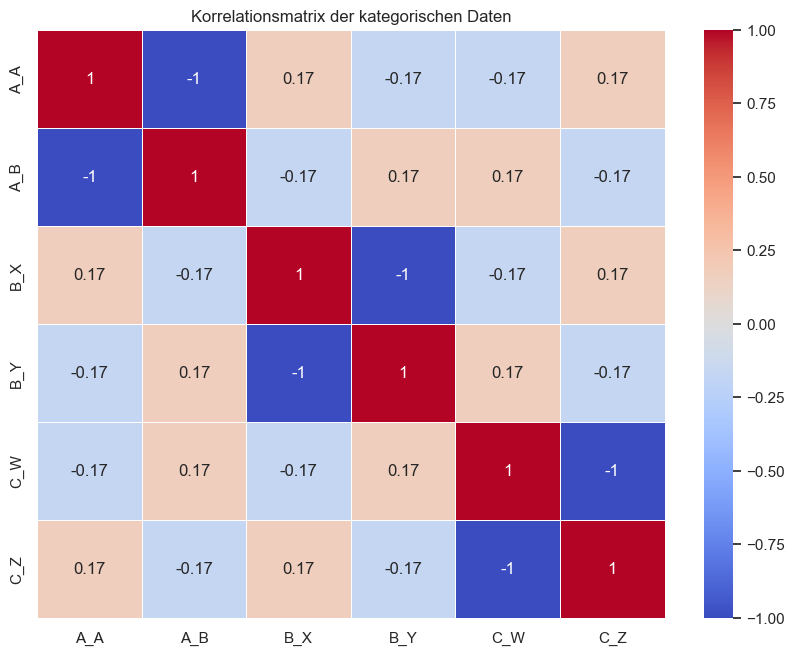

In [360]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Konvertiere kategorische Daten in numerische Werte
data_encoded = pd.get_dummies(data)

# Berechne die Korrelationsmatrix
correlation_matrix = data_encoded.corr()

# Erstelle eine Heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Korrelationsmatrix der kategorischen Daten')
plt.show()

In [361]:
for column in data.columns:
    unique_values = data[column].unique()
    print(f"Spalte '{column}': {unique_values}")

Spalte 'A': ['A' 'B']
Spalte 'B': ['X' 'Y']
Spalte 'C': ['W' 'Z']


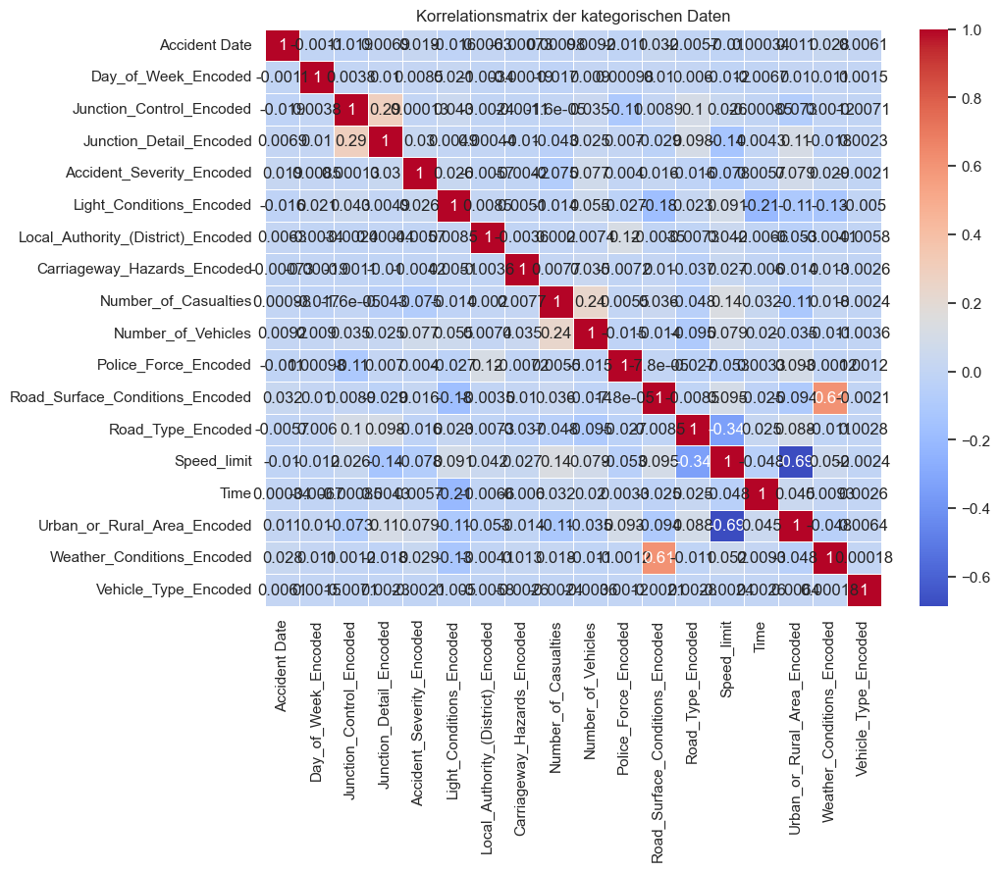

In [362]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Konvertiere kategorische Daten in numerische Werte
data_encoded = pd.get_dummies(encoded_data)

# Berechne die Korrelationsmatrix
correlation_matrix = data_encoded.corr()

# Erstelle eine Heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Korrelationsmatrix der kategorischen Daten')
plt.show()

In [372]:
import pandas as pd
from scipy.stats import chi2_contingency

# Lade deine Daten in ein Pandas DataFrame
# Annahme: Die Daten sind in der Datei 'daten.csv' gespeichert
df = encoded_data

# Wähle die relevanten Spalten aus
selected_columns = ['Junction_Control_Encoded', 'Light_Conditions_Encoded', 'Road_Type_Encoded']  # Füge hier die Namen deiner Spalten hinzu

def cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k - 1) * (r - 1)) / (n - 1))
    rcorr = r - ((r - 1) ** 2) / (n - 1)
    kcorr = k - ((k - 1) ** 2) / (n - 1)
    return (phi2corr / min((kcorr - 1), (rcorr - 1))) ** 0.5

# Korrelationsmatrix erstellen
correlation_matrix = pd.DataFrame(index=[], columns=[])

# Korrelation zwischen Kategorien in jeder Spalte berechnen
for col1 in selected_columns:
    for col2 in selected_columns:
        if col1 != col2:
            # Gruppierung der Daten nach Kategorien in den beiden Spalten
            grouped_data = df.groupby([col1, col2]).size().unstack(fill_value=0)
            # Berechnung der Korrelation zwischen den Kategorien
            correlation = cramers_v(grouped_data)
            # Hinzufügen der Korrelation zur Matrix
            correlation_matrix.loc[col1 + '-' + col2, 'correlation'] = correlation

print(correlation_matrix)


                                                   correlation
Junction_Control_Encoded-Light_Conditions_Encoded     0.102511
Junction_Control_Encoded-Road_Type_Encoded            0.146315
Light_Conditions_Encoded-Junction_Control_Encoded     0.102511
Light_Conditions_Encoded-Road_Type_Encoded            0.039373
Road_Type_Encoded-Junction_Control_Encoded            0.146315
Road_Type_Encoded-Light_Conditions_Encoded            0.039373


In [359]:
import pandas as pd

# Annahme: DataFrame "df" enthält deine Daten

# Erstelle eine leere DataFrame für die Kreuztabelle
cross_table = pd.DataFrame(index=data.columns, columns=data.columns)

# Fülle die Kreuztabelle mit Korrelationen zwischen den Kategorien in den Spalten
for col1 in data.columns:
    for col2 in data.columns:
        if col1 != col2:  # Überspringe die gleichen Spalten (Diagonale)
            crosstab_result = pd.crosstab(data[col1], data[col2])
            corr = crosstab_result.corr().iloc[0, 1]  # Korrelation zwischen den Häufigkeiten
            cross_table.loc[col1, col2] = corr

# Zeige die Korrelationsmatrix zwischen den Kategorien in den Spalten an
print(cross_table)


     A    B    C
A  NaN  NaN  NaN
B  NaN  NaN  NaN
C  NaN  NaN  NaN


In [336]:
import pandas as pd

# Beispiel DataFrame mit x- und y-Daten
data = pd.DataFrame({'x': [1, 1, 3, 1, 2, 3, 1, 2, 3],
                     'y': [1, 1, 1, 2, 2, 2, 3, 3, 3]})

# Gruppieren nach x und y und die Anzahl der Zeilen pro Gruppe zählen
frequency = data.groupby(['x', 'y']).size().reset_index(name='count')

print(frequency)

   x  y  count
0  1  1      2
1  1  2      1
2  1  3      1
3  2  2      1
4  2  3      1
5  3  1      1
6  3  2      1
7  3  3      1


In [310]:
df = pd.DataFrame(data)
print(df)
print(data)
# Löschen der unerwünschten Spalten
columns_to_drop = ['Longitude', 'Latitude', 'Accident_Index', 'Accident Date', 'Time']
df = df.drop(columns_to_drop, axis=1, errors='ignore')
print(df)
# Setzen des Index zurück, um sicherzustellen, dass die apply-Funktion nicht auf den Index angewendet wird
df.reset_index(drop=True, inplace=True)

# Konvertieren alle Werte in Zeichenfolgen
df = df.astype(str)

# Kombinieren der Werte in jeder Zeile zu einer neuen Spalte namens 'Combined'
df['Combined'] = df.apply(lambda row: '_'.join(row), axis=1)

# Gruppieren der Daten nach der kombinierten Spalte und Zählen der Ereignisse
summary_table = df.groupby('Combined').size().reset_index(name='Count')

# Ausgabe der Zusammenfassungstabelle h#
print(summary_table)

       Accident_Index Accident Date Day_of_Week              Junction_Control  \
0       200901BS70001    2021-01-01    Thursday      Give way or uncontrolled   
1       200901BS70002    2021-01-05      Monday      Give way or uncontrolled   
2       200901BS70003    2021-01-04      Sunday      Give way or uncontrolled   
3       200901BS70004    2021-01-05      Monday           Auto traffic signal   
4       200901BS70005    2021-01-06     Tuesday           Auto traffic signal   
...               ...           ...         ...                           ...   
307968  201091NM01760    2022-02-18    Thursday  Data missing or out of range   
307969  201091NM01881    2022-02-21      Sunday  Data missing or out of range   
307970  201091NM01935    2022-02-23     Tuesday      Give way or uncontrolled   
307971  201091NM01964    2022-02-23     Tuesday      Give way or uncontrolled   
307972  201091NM02142    2022-02-28      Sunday      Give way or uncontrolled   

                           

In [311]:
from dash import Dash, html, dcc, callback, Output, Input
import plotly.express as px
import pandas as pd

df = data

app = Dash(__name__)

app.layout = html.Div([
    html.H1(children='Title of Dash App', style={'textAlign':'center'}),
    dcc.Dropdown(df.country.unique(), 'Canada', id='dropdown-selection'),
    dcc.Graph(id='graph-content')
])

@callback(
    Output('graph-content', 'figure'),
    Input('dropdown-selection', 'value')
)
def update_graph(value):
    dff = df[df.country==value]
    return px.line(dff, x='year', y='pop')

if __name__ == '__main__':
    app.run(debug=True)


AttributeError: 'DataFrame' object has no attribute 'country'

In [312]:
import streamlit as st 
st.title("ey")

2024-05-06 19:17:50.654 
  command:

    streamlit run C:\Users\vanes\AppData\Roaming\Python\Python311\site-packages\ipykernel_launcher.py [ARGUMENTS]


DeltaGenerator()